In [1]:
data_location =  "/kaggle/input/flickr8k"

In [2]:
#imports
import os
from collections import Counter
import spacy

import torch
from torch.nn.utils.rnn import pad_sequence, pack_padded_sequence
from torch.utils.data import DataLoader,Dataset, random_split
import torchvision.transforms as T
import torch.nn as nn
import torchvision

import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from PIL import Image
import re

In [3]:
import pandas as pd
caption_file = data_location + '/captions.txt'
df = pd.read_csv(caption_file)
print("There are {} image to captions".format(len(df)))
df.head(7)

There are 40455 image to captions


,image,caption
0,1000268201_693b08cb0e.jpg,A child in a pink dress is climbing up a set o...
1,1000268201_693b08cb0e.jpg,A girl going into a wooden building .
2,1000268201_693b08cb0e.jpg,A little girl climbing into a wooden playhouse .
3,1000268201_693b08cb0e.jpg,A little girl climbing the stairs to her playh...
4,1000268201_693b08cb0e.jpg,A little girl in a pink dress going into a woo...
5,1001773457_577c3a7d70.jpg,A black dog and a spotted dog are fighting
6,1001773457_577c3a7d70.jpg,A black dog and a tri-colored dog playing with...


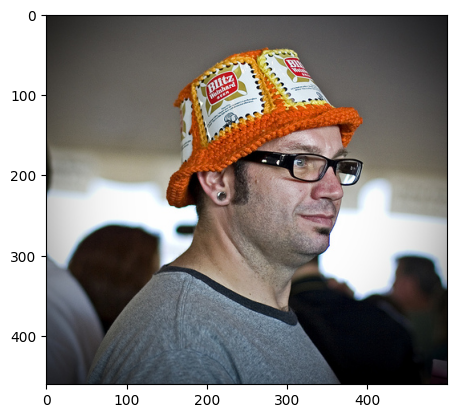

Caption: A man wears an orange hat and glasses .
Caption: A man with gauges and glasses is wearing a Blitz hat .
Caption: A man with glasses is wearing a beer can crocheted hat .
Caption: The man with pierced ears is wearing glasses and an orange hat .
Caption: A child playing on a rope net .


In [4]:
#select any index from the whole dataset
#single image has 5 captions

data_idx = 21

image_path = data_location+"/Images/"+df.iloc[data_idx,0]
img=mpimg.imread(image_path)
plt.imshow(img)
plt.show()

#image consits of 5 captions,
#showing all 5 captions of the image of the given idx
for i in range(data_idx,data_idx+5):
    print("Caption:",df.iloc[i,1])

In [5]:
#using spacy for the better text tokenization
spacy_eng = spacy.load("en_core_web_sm")

#example
text = "This is a good place to find a city"
[token.text.lower() for token in spacy_eng.tokenizer(text)]

['this', 'is', 'a', 'good', 'place', 'to', 'find', 'a', 'city']

# **1. Create Vocab and Preprocessing Caption**


In [6]:
class Vocabulary:
    def __init__(self,freq_threshold):
        #setting the pre-reserved tokens int to string tokens
        self.itos = {0:"<PAD>",1:"<SOS>",2:"<EOS>",3:"<UNK>"}

        #string to int tokens
        #its reverse dict self.itos
        self.stoi = {v:k for k,v in self.itos.items()}

        self.freq_threshold = freq_threshold

    def __len__(self): return len(self.itos)

    @staticmethod
    def tokenize(text):
        return [token.text.lower() for token in spacy_eng.tokenizer(text)]

    def build_vocab(self, sentence_list):
        frequencies = Counter()
        idx = 4

        for sentence in sentence_list:
            for word in self.tokenize(sentence):
                frequencies[word] += 1

                #add the word to the vocab if it reaches minum frequecy threshold
                if frequencies[word] == self.freq_threshold:
                    self.stoi[word] = idx
                    self.itos[idx] = word
                    idx += 1

    def numericalize(self,text):
        """ For each word in the text corresponding index token for that word form the vocab built as list """
        tokenized_text = self.tokenize(text)
        return [ self.stoi[token] if token in self.stoi else self.stoi["<UNK>"] for token in tokenized_text ]

In [7]:
v = Vocabulary(freq_threshold=1)

v.build_vocab(["A child in a pink dress is climbing up a set of stairs in an entry way ."])
print(v.stoi)
print(v.numericalize("A child in a pink dress is climbing up a set of stairs in an entry way ."))

{'<PAD>': 0, '<SOS>': 1, '<EOS>': 2, '<UNK>': 3, 'a': 4, 'child': 5, 'in': 6, 'pink': 7, 'dress': 8, 'is': 9, 'climbing': 10, 'up': 11, 'set': 12, 'of': 13, 'stairs': 14, 'an': 15, 'entry': 16, 'way': 17, '.': 18}
[4, 5, 6, 4, 7, 8, 9, 10, 11, 4, 12, 13, 14, 6, 15, 16, 17, 18]


In [8]:
slip = 'test'

print(slip == 'test')

True


# **2. Create Custom Dataset**

In [9]:
class FlickrDataset(Dataset):
    """
    FlickrDataset
    """
    def __init__(self,root_dir, captions_file, transform=None, freq_threshold=1, allCaps = False):
        self.root_dir = root_dir
        self.df = pd.read_csv(caption_file)
        self.transform = transform
        self.allCaps = allCaps

        #Get image and caption colum from the dataframe
        self.imgs = self.df["image"]
        self.captions = self.df["caption"]

        #Initialize vocabulary and build vocab
        self.vocab = Vocabulary(freq_threshold)
        self.vocab.build_vocab(self.captions.tolist())


    def __len__(self):
        return len(self.df)

    def __getitem__(self,idx):
        cpi = 5
        
        caption = self.captions[idx]
        img_name = self.imgs[idx]
        img_location = os.path.join(self.root_dir,img_name)
        img = Image.open(img_location).convert("RGB")

        #apply the transfromation to the image
        if self.transform is not None:
            img = self.transform(img)

        #numericalize the caption text
        caption_vec = []
        caption_vec += [self.vocab.stoi["<SOS>"]]
        caption_vec += self.vocab.numericalize(caption)
        caption_vec += [self.vocab.stoi["<EOS>"]]
        
        if self.allCaps == False:
            return img, torch.tensor(caption_vec)
        else:
            all_captions = self.captions[((idx // cpi) * cpi) : (((idx // cpi) * cpi) + cpi)]
            all_captions_ids = [self.vocab.numericalize(caption) for caption in all_captions]
            return img, torch.tensor(caption_vec), all_captions_ids

        

In [10]:
class CapsCollate:
    """
    Collate to apply the padding to the captions with dataloader
    """
    def __init__(self,pad_idx,batch_first=False, allCaps = False):
        self.pad_idx = pad_idx
        self.batch_first = batch_first
        self.allCaps = allCaps

    def __call__(self,batch):
        imgs = [item[0].unsqueeze(0) for item in batch]
        imgs = torch.cat(imgs,dim=0)

        targets = [item[1] for item in batch]
        targets = pad_sequence(targets, batch_first=self.batch_first, padding_value=self.pad_idx)
    
        if self.allCaps == False:
            return imgs,targets
        else:
            all_targets = [item[2] for item in batch]
            return imgs, targets, all_targets
                    
        

In [28]:
BATCH_SIZE = 128
# BATCH_SIZE = 6
NUM_WORKER = 4

df = pd.read_csv(data_location + '/captions.txt')
captions = df['caption']
vocab = Vocabulary(1)
vocab.build_vocab(captions.tolist())

#defining the transform to be applied
transforms = T.Compose([
    T.Resize(226),
    T.RandomCrop(224),
    T.ToTensor(),
    T.Normalize((0.485, 0.456, 0.406),(0.229, 0.224, 0.225))
])

#testing the dataset class
dataset =  FlickrDataset(
    root_dir = data_location+"/Images",
    captions_file = data_location+"/captions.txt",
    transform=transforms
)

train_size = int(0.8 * dataset.__len__())  # 80% for training
test_size = int(0.1 * dataset.__len__())  # 20% for testing
val_size = dataset.__len__() - train_size - test_size

# Split the dataset
train_dataset, test_dataset, val_dataset = random_split(dataset, [train_size, test_size, val_size])

pad_idx = dataset.vocab.stoi["<PAD>"]
print(pad_idx)

#writing the dataloader
train_loader = DataLoader(
    dataset=train_dataset,
    batch_size=BATCH_SIZE,
    num_workers=NUM_WORKER,
    shuffle=True,
    collate_fn = CapsCollate(pad_idx, batch_first=True),
)

val_loader = DataLoader(
    dataset=val_dataset,
    batch_size=BATCH_SIZE,
    num_workers=NUM_WORKER,
    shuffle=True,
    collate_fn = CapsCollate(pad_idx, batch_first=True),
)

#vocab_size
vocab_size = len(dataset.vocab)

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
device

0


device(type='cuda', index=0)

# **3. Define Model**

## Encoder


In [29]:
class EncoderCNN(nn.Module):
    """
    Encoder using CNN model
    """

    def __init__(self, encoded_image_size=14):
        super(EncoderCNN, self).__init__()
        self.enc_image_size = encoded_image_size

        resnet = torchvision.models.resnet50(weights='DEFAULT')

        # Remove linear and pool layers
        modules = list(resnet.children())[:-2]
        self.resnet = nn.Sequential(*modules)

        # Resize image to fixed size to allow input images of variable size
        self.adaptive_pool = nn.AdaptiveAvgPool2d((encoded_image_size, encoded_image_size))

        self.fine_tune()


    def forward(self, images):
        """
        Forward propagation.

        :param images: images, a tensor of dimensions (batch_size, 3, image_size, image_size)
        :return: encoded images
        """

        out = self.resnet(images)  # (batch_size, 2048, image_size/32, image_size/32)
        out = self.adaptive_pool(out)  # (batch_size, 2048, encoded_image_size, encoded_image_size)
        out = out.permute(0, 2, 3, 1)  # (batch_size, encoded_image_size, encoded_image_size, 2048)
        return out


    def fine_tune(self, fine_tune=True):
        """
        Allow or prevent the computation of gradients for convolutional blocks 2 through 4 of the encoder.

        :param fine_tune: Allow?
        """

        for p in self.resnet.parameters():
            p.requires_grad = False
        # If fine-tuning, only fine-tune convolutional blocks 2 through 4
        for c in list(self.resnet.children())[5:]:
            for p in c.parameters():
                p.requires_grad = fine_tune

## Attention

In [30]:
class Attention(nn.Module):
    """
    Attention Network.
    """

    def __init__(self, encoder_dim, decoder_dim, attention_dim):
        """
        :param encoder_dim: feature size of encoded images
        :param decoder_dim: size of decoder's RNN
        :param attention_dim: size of the attention network
        """
        super(Attention, self).__init__()
        self.encoder_att = nn.Linear(encoder_dim, attention_dim)  # linear layer to transform encoded image
        self.decoder_att = nn.Linear(decoder_dim, attention_dim)  # linear layer to transform decoder's output
        self.full_att = nn.Linear(attention_dim, 1)  # linear layer to calculate values to be softmax-ed
        self.relu = nn.ReLU()
        self.softmax = nn.Softmax(dim=1)  # softmax layer to calculate weights

    def forward(self, encoder_out, decoder_hidden):
        """
        Forward propagation.

        :param encoder_out: encoded images, a tensor of dimension (batch_size, num_pixels, encoder_dim)
        :param decoder_hidden: previous decoder output, a tensor of dimension (batch_size, decoder_dim)
        :return: attention weighted encoding, weights
        """
        att1 = self.encoder_att(encoder_out)  # (batch_size, num_pixels, attention_dim)
        att2 = self.decoder_att(decoder_hidden)  # (batch_size, attention_dim)
        att = self.full_att(self.relu(att1 + att2.unsqueeze(1))).squeeze(2)  # (batch_size, num_pixels)
        alpha = self.softmax(att)  # (batch_size, num_pixels)
        attention_weighted_encoding = (encoder_out * alpha.unsqueeze(2)).sum(dim=1)  # (batch_size, encoder_dim)

        return attention_weighted_encoding, alpha

## Decoder

In [31]:
class DecoderWithoutAttention(nn.Module):
    """
    Decoder without attention using greedy search for caption generation.
    """

    def __init__(self, embed_dim, decoder_dim, vocab_size, encoder_dim=2048, dropout=0.5):
        """
        :param embed_dim: embedding size
        :param decoder_dim: size of decoder's RNN
        :param vocab_size: size of vocabulary
        :param encoder_dim: feature size of encoded images
        :param dropout: dropout
        """
        super(DecoderWithoutAttention, self).__init__()

        self.encoder_dim = encoder_dim
        self.embed_dim = embed_dim
        self.decoder_dim = decoder_dim
        self.vocab_size = vocab_size
        self.dropout = dropout
        
        self.embedding = nn.Embedding(vocab_size, embed_dim)  # embedding layer
        
        self.dropout = nn.Dropout(p=self.dropout)
        self.decode_step = nn.LSTMCell(embed_dim, decoder_dim, bias=True)  # decoding LSTMCell
        self.init_h = nn.Linear(encoder_dim, decoder_dim)  # linear layer to find initial hidden state of LSTMCell
        self.init_c = nn.Linear(encoder_dim, decoder_dim)  # linear layer to find initial cell state of LSTMCell
        self.fc = nn.Linear(decoder_dim, vocab_size)  # linear layer to find scores over vocabulary
        self.init_weights()  # initialize some layers with the uniform distribution
        
    def init_weights(self):
        """
        Initializes some parameters with values from the uniform distribution, for easier convergence.
        """
        self.embedding.weight.data.uniform_(-0.1, 0.1)
        self.fc.bias.data.fill_(0)
        self.fc.weight.data.uniform_(-0.1, 0.1)
        
    def init_hidden_state(self, encoder_out):
        """
        Creates the initial hidden and cell states for the decoder's LSTM based on the encoded images.

        :param encoder_out: encoded images, a tensor of dimension (batch_size, num_pixels, encoder_dim)
        :return: hidden state, cell state
        """
        mean_encoder_out = encoder_out.mean(dim=1)
        h = self.init_h(mean_encoder_out)  # (batch_size, decoder_dim)
        c = self.init_c(mean_encoder_out)
        return h, c

    def forward(self, encoder_out, encoded_captions, caption_lengths):
        """
        Forward propagation.

        :param encoder_out: encoded images, a tensor of dimension (batch_size, enc_image_size, enc_image_size, encoder_dim)
        :param encoded_captions: encoded captions, a tensor of dimension (batch_size, max_caption_length)
        :param caption_lengths: caption lengths, a tensor of dimension (batch_size)
        :return: scores for vocabulary
        """

        batch_size = encoder_out.size(0)
        encoder_dim = encoder_out.size(-1)
        
        # Flatten image
        encoder_out = encoder_out.view(batch_size, -1, encoder_dim)  # (batch_size, num_pixels, encoder_dim)
        
        # We won't decode at the <end> position, since we've finished generating as soon as we generate <end>
        # So, decoding lengths are actual lengths - 1
        caption_lengths, sort_ind = caption_lengths.sort(dim=0, descending=True)
        encoder_out = encoder_out[sort_ind]
        encoded_captions = encoded_captions[sort_ind]

        # Embedding
        embeddings = self.embedding(encoded_captions)  # (batch_size, max_caption_length, embed_dim)
        
        # Initialize LSTM state
        h, c = self.init_hidden_state(encoder_out)  # (batch_size, decoder_dim)
        

        decode_lengths = (caption_lengths - 1).tolist()
        predictions = torch.zeros(batch_size, max(decode_lengths), vocab_size).to(device)

        for t in range(max(decode_lengths)):
            batch_size_t = sum([l > t for l in decode_lengths])
            h, c = self.decode_step(embeddings[:batch_size_t, t, :], (h[:batch_size_t], c[:batch_size_t]))  # (batch_size_t, decoder_dim)
            preds = self.fc(self.dropout(h))  # (batch_size_t, vocab_size)
            predictions[:batch_size_t, t, :] = preds
            
        return predictions, encoded_captions, decode_lengths, sort_ind

In [32]:
import torch.nn.functional as F

class DecoderWithAttention(nn.Module):
    """
    Decoder.
    """

    def __init__(self, attention_dim, embed_dim, decoder_dim, vocab_size, encoder_dim=2048, dropout=0.5):
        """
        :param attention_dim: size of attention network
        :param embed_dim: embedding size
        :param decoder_dim: size of decoder's RNN
        :param vocab_size: size of vocabulary
        :param encoder_dim: feature size of encoded images
        :param dropout: dropout
        """
        super(DecoderWithAttention, self).__init__()

        self.encoder_dim = encoder_dim
        self.attention_dim = attention_dim
        self.embed_dim = embed_dim
        self.decoder_dim = decoder_dim
        self.vocab_size = vocab_size
        self.dropout = dropout

        self.attention = Attention(encoder_dim, decoder_dim, attention_dim)  # attention network

        self.embedding = nn.Embedding(vocab_size, embed_dim)  # embedding layer
        self.dropout = nn.Dropout(p=self.dropout)
        self.decode_step = nn.LSTMCell(embed_dim + encoder_dim, decoder_dim, bias=True)  # decoding LSTMCell
        self.init_h = nn.Linear(encoder_dim, decoder_dim)  # linear layer to find initial hidden state of LSTMCell
        self.init_c = nn.Linear(encoder_dim, decoder_dim)  # linear layer to find initial cell state of LSTMCell
        self.f_beta = nn.Linear(decoder_dim, encoder_dim)  # linear layer to create a sigmoid-activated gate
        self.sigmoid = nn.Sigmoid()
        self.fc = nn.Linear(decoder_dim, vocab_size)  # linear layer to find scores over vocabulary
        self.init_weights()  # initialize some layers with the uniform distribution

    def init_weights(self):
        """
        Initializes some parameters with values from the uniform distribution, for easier convergence.
        """
        self.embedding.weight.data.uniform_(-0.1, 0.1)
        self.fc.bias.data.fill_(0)
        self.fc.weight.data.uniform_(-0.1, 0.1)

    def load_pretrained_embeddings(self, embeddings):
        """
        Loads embedding layer with pre-trained embeddings.

        :param embeddings: pre-trained embeddings
        """
        self.embedding.weight = nn.Parameter(embeddings)

    def fine_tune_embeddings(self, fine_tune=True):
        """
        Allow fine-tuning of embedding layer? (Only makes sense to not-allow if using pre-trained embeddings).

        :param fine_tune: Allow?
        """
        for p in self.embedding.parameters():
            p.requires_grad = fine_tune

    def init_hidden_state(self, encoder_out):
        """
        Creates the initial hidden and cell states for the decoder's LSTM based on the encoded images.

        :param encoder_out: encoded images, a tensor of dimension (batch_size, num_pixels, encoder_dim)
        :return: hidden state, cell state
        """
        mean_encoder_out = encoder_out.mean(dim=1)
        h = self.init_h(mean_encoder_out)  # (batch_size, decoder_dim)
        c = self.init_c(mean_encoder_out)
        return h, c

    def forward(self, encoder_out, encoded_captions, caption_lengths):
        """
        Forward propagation.

        :param encoder_out: encoded images, a tensor of dimension (batch_size, enc_image_size, enc_image_size, encoder_dim)
        :param encoded_captions: encoded captions, a tensor of dimension (batch_size, max_caption_length)
        :return: scores for vocabulary, sorted encoded captions, decode lengths, weights, sort indices
        """

        batch_size = encoder_out.size(0)
        encoder_dim = encoder_out.size(-1)
        vocab_size = self.vocab_size

        # Flatten image
        encoder_out = encoder_out.view(batch_size, -1, encoder_dim)  # (batch_size, num_pixels, encoder_dim)
        num_pixels = encoder_out.size(1)

        # We won't decode at the <end> position, since we've finished generating as soon as we generate <end>
        # So, decoding lengths are actual lengths - 1
        caption_lengths, sort_ind = caption_lengths.sort(dim=0, descending=True)
        encoder_out = encoder_out[sort_ind]
        encoded_captions = encoded_captions[sort_ind]

        # Embedding
        embeddings = self.embedding(encoded_captions)  # (batch_size, max_caption_length, embed_dim)

        # Initialize LSTM state
        h, c = self.init_hidden_state(encoder_out)  # (batch_size, decoder_dim)
        
        decode_lengths = (caption_lengths - 1).tolist()
        predictions = torch.zeros(batch_size, max(decode_lengths), vocab_size).to(device)
        alphas = torch.zeros(batch_size, max(decode_lengths), num_pixels).to(device)

        # At each time-step, decode by
        # attention-weighing the encoder's output based on the decoder's previous hidden state output
        # then generate a new word in the decoder with the previous word and the attention weighted encoding
        for t in range(max(decode_lengths)):
            batch_size_t = sum([l > t for l in decode_lengths])
            attention_weighted_encoding, alpha = self.attention(encoder_out[:batch_size_t],
                                                                h[:batch_size_t])
            gate = self.sigmoid(self.f_beta(h[:batch_size_t]))  # gating scalar, (batch_size_t, encoder_dim)
            attention_weighted_encoding = gate * attention_weighted_encoding
            h, c = self.decode_step(
                torch.cat([embeddings[:batch_size_t, t, :], attention_weighted_encoding], dim=1),
                (h[:batch_size_t], c[:batch_size_t]))  # (batch_size_t, decoder_dim)
            preds = self.fc(self.dropout(h))  # (batch_size_t, vocab_size)
            predictions[:batch_size_t, t, :] = preds
            alphas[:batch_size_t, t, :] = alpha

        return predictions, encoded_captions, decode_lengths, alphas, sort_ind

# **4. Utils**

In [33]:
def adjust_learning_rate(optimizer, shrink_factor):
    """
    Shrinks learning rate by a specified factor.

    :param optimizer: optimizer whose learning rate must be shrunk.
    :param shrink_factor: factor in interval (0, 1) to multiply learning rate with.
    """

    print("\nDECAYING learning rate.")
    for param_group in optimizer.param_groups:
        param_group['lr'] = param_group['lr'] * shrink_factor
    print("The new learning rate is %f\n" % (optimizer.param_groups[0]['lr'],))

In [34]:
def clip_gradient(optimizer, grad_clip):
    """
    Clips gradients computed during backpropagation to avoid explosion of gradients.

    :param optimizer: optimizer with the gradients to be clipped
    :param grad_clip: clip value
    """
    for group in optimizer.param_groups:
        for param in group['params']:
            if param.grad is not None:
                param.grad.data.clamp_(-grad_clip, grad_clip)

In [35]:
class AverageMeter(object):
    """
    Keeps track of most recent, average, sum, and count of a metric.
    """

    def __init__(self):
        self.reset()

    def reset(self):
        self.val = 0
        self.avg = 0
        self.sum = 0
        self.count = 0

    def update(self, val, n=1):
        self.val = val
        self.sum += val * n
        self.count += n
        self.avg = self.sum / self.count

In [36]:
def show_image(img, title=None):
    """Imshow for Tensor."""
    
    #unnormalize 
    img[0] = img[0] * 0.229
    img[1] = img[1] * 0.224 
    img[2] = img[2] * 0.225 
    img[0] += 0.485 
    img[1] += 0.456 
    img[2] += 0.406
    
    img = img.numpy().transpose((1, 2, 0))
    
    
    plt.imshow(img)
    if title is not None:
        plt.title(title)
    plt.pause(0.001)  # pause a bit so that plots are updated

In [37]:
def save_checkpoint(data_name, epoch, epochs_since_improvement, encoder, decoder, encoder_optimizer, decoder_optimizer,
                    bleu4, is_best):

    state = {'epoch': epoch,
             'epochs_since_improvement': epochs_since_improvement,
             'bleu-4': bleu4,
             'encoder': encoder,
             'decoder': decoder,
             'encoder_optimizer': encoder_optimizer,
             'decoder_optimizer': decoder_optimizer}
    filename = 'checkpoint_' + data_name + '.pth.tar'
    torch.save(state, filename)
    # If this checkpoint is the best so far, store a copy so it doesn't get overwritten by a worse checkpoint
    if is_best:
        torch.save(state, 'BEST_' + filename)

# **5. Trainning**

## Config

In [38]:
emb_dim = 300  # dimension of word embeddings
attention_dim = 256  # dimension of attention linear layers
decoder_dim = 512  # dimension of decoder RNN
dropout = 0.5

encoder_lr = 1e-4  # learning rate for encoder if fine-tuning
decoder_lr = 3e-4  # learning rate for decoder

fine_tune_encoder = True


In [39]:
decoder = DecoderWithAttention(attention_dim = attention_dim,
                                       embed_dim = emb_dim,
                                       decoder_dim = decoder_dim,
                                       vocab_size = vocab_size,
                                       dropout = dropout)

decoder_optimizer = torch.optim.Adam(params=filter(lambda p: p.requires_grad, decoder.parameters()),
                                      lr=decoder_lr)

encoder = EncoderCNN()
encoder.fine_tune(fine_tune_encoder)
encoder_optimizer = torch.optim.Adam(params=filter(lambda p: p.requires_grad, encoder.parameters()),
                                      lr=encoder_lr) if fine_tune_encoder else None

 # Move to GPU, if available
decoder = decoder.to(device)
encoder = encoder.to(device)

# Loss function
criterion = nn.CrossEntropyLoss(ignore_index=dataset.vocab.stoi["<PAD>"]).to(device)

In [40]:
decoder_noAtt = DecoderWithoutAttention(embed_dim = emb_dim,
                                       decoder_dim = decoder_dim,
                                       vocab_size = vocab_size)

decoder_noAtt_optimizer = torch.optim.Adam(params=filter(lambda p: p.requires_grad, decoder_noAtt.parameters()),
                                      lr=decoder_lr)

encoder_noAtt = EncoderCNN()
encoder_noAtt.fine_tune(fine_tune_encoder)
encoder_noAtt_optimizer = torch.optim.Adam(params=filter(lambda p: p.requires_grad, encoder_noAtt.parameters()),
                                      lr=encoder_lr) if fine_tune_encoder else None

 # Move to GPU, if available
decoder_noAtt = decoder_noAtt.to(device)
encoder_noAtt = encoder_noAtt.to(device)

# Loss function
criterion_noAtt = nn.CrossEntropyLoss(ignore_index=dataset.vocab.stoi["<PAD>"]).to(device)

## Train and Validate


In [41]:
from nltk.translate.bleu_score import corpus_bleu, sentence_bleu, SmoothingFunction

def validate(val_loader, encoder, decoder, criterion, attention = True):
    decoder.eval()  # eval mode (no dropout or batchnorm)
    if encoder is not None:
        encoder.eval()

    batch_time = AverageMeter()
    losses = AverageMeter()

    start = time.time()

    references = list()  # references (true captions) for calculating BLEU-4 score
    hypotheses = list()  # hypotheses (predictions)

    # explicitly disable gradient calculation to avoid CUDA memory error
    # solves the issue #57
    with torch.no_grad():
        # Batches
        img = None
        for i, (imgs, caps) in enumerate(val_loader):

            # Move to device, if available
            images = imgs.to(device)
            caps = caps.to(device)
            
            # Compute caption lengths
            caps_eos = caps == dataset.vocab.stoi['<EOS>']
            captions_lengths = torch.max(caps_eos.int(), dim=1)[1] + 1

            # Forward prop.
            if encoder is not None:
                imgs_encoded = encoder(images)
            
            if attention == True:
                preds, caps_sorted, decode_lengths, alphas, sort_ind = decoder(imgs_encoded, caps, captions_lengths)
            else:
                preds, caps_sorted, decode_lengths, sort_ind = decoder(imgs_encoded, caps, captions_lengths)

            # Since we decoded starting with <start>, the targets are all words after <start>, up to <end>
            targets = caps_sorted[:, 1:]
            
            # Remove timesteps that we didn't decode at, or are pads
            # pack_padded_sequence is an easy trick to do this
            preds_copy = preds.clone()
            targets = pack_padded_sequence(targets, decode_lengths, batch_first=True).data
            preds = pack_padded_sequence(preds, decode_lengths, batch_first=True).data

            # Calculate loss
            loss = criterion(preds, targets)
            
            if attention == True:
                # Add doubly stochastic attention regularization
                loss += alpha_c * ((1. - alphas.sum(dim=1)) ** 2).mean()

            # Keep track of metrics
            losses.update(loss.item(), sum(decode_lengths))
            batch_time.update(time.time() - start)

            start = time.time()

            if i % print_freq == 0:
                print('Validation: [{0}/{1}]\t'
                      'Batch Time {batch_time.val:.3f} ({batch_time.avg:.3f})\t'
                      'Loss {loss.val:.4f} ({loss.avg:.4f})\t'.format(i, len(val_loader), batch_time=batch_time,
                                                                      loss=losses))

            # References
            sort_ind_list = sort_ind.tolist()  # Convert sort_ind tensor to a list
            caps = [caps[ind] for ind in sort_ind_list]  # because images were sorted in the decoder
            imgs = [imgs[ind] for ind in sort_ind_list]
            for j in range(len(caps)):
                img_caps = caps[j].tolist()
                caption_label = [vocab.itos[token] for token in img_caps]
                eos_index = caption_label.index('<EOS>')
                caption_label = caption_label[1:eos_index]
                references.append([caption_label])
                
            # Hypotheses
            _, preds = torch.max(preds_copy, dim=2)
            preds = preds.tolist()
            temp_preds = []
            for j, p in enumerate(preds):
                pred_caption = []
                for token in preds[j]:
                    if token == vocab.stoi["<EOS>"]:
                        break  # Stop generating if <EOS> is predicted
                    if token != vocab.stoi["<PAD>"]:
                        pred_caption.append(vocab.itos[token])
                temp_preds.append(pred_caption)
            preds = temp_preds
            hypotheses.extend(preds)
            
#             hypo_batch = decoder.generate_caption(imgs_encoded, vocab)  # Use beam search to generate hypotheses
#             hypotheses.extend(hypo_batch)
        
            assert len(references) == len(hypotheses)
            img = imgs[-1]
            
        print(references[-1])
        show_image(img,title=hypotheses[-1])
        
        # Calculate BLEU-4 scores
        smoothie = SmoothingFunction().method4
        bleu4 = corpus_bleu(references, hypotheses, smoothing_function = smoothie)

        print(
            '\n * LOSS - {loss.avg:.3f}, BLEU-4 - {bleu}\n'.format(
                loss=losses,
                bleu=bleu4))

    return bleu4


In [42]:
from torch.nn.utils.rnn import pack_padded_sequence
import time

print_freq = 100  # print training/validation stats every __ batches
grad_clip = 5.  # clip gradients at an absolute value of
alpha_c = 1.  # regularization parameter for 'doubly stochastic attention', as in the paper

def train(train_loader, encoder, decoder, criterion, encoder_optimizer, decoder_optimizer, epoch, attention = True):
    """
    Performs one epoch's training.

    :param train_loader: DataLoader for training data
    :param encoder: encoder model
    :param decoder: decoder model
    :param criterion: loss layer
    :param encoder_optimizer: optimizer to update encoder's weights (if fine-tuning)
    :param decoder_optimizer: optimizer to update decoder's weights
    :param epoch: epoch number
    """

    decoder.train()  # train mode (dropout and batchnorm is used)
    encoder.train()

    batch_time = AverageMeter()  # forward prop. + back prop. time
    losses = AverageMeter()  # loss (per word decoded)
    data_time = AverageMeter()  # data loading time

    start = time.time()

    for i, (imgs, caps) in enumerate(train_loader):
        data_time.update(time.time() - start)

        # Move to GPU, if available
        imgs = imgs.to(device)
        caps = caps.to(device)
        
        # Compute caption lengths
        caps_eos = caps == dataset.vocab.stoi['<EOS>']
        captions_lengths = torch.max(caps_eos.int(), dim=1)[1] + 1

        # Forward prop.
        imgs_encoded = encoder(imgs)
        if attention == True:
            preds, caps_sorted, decode_lengths, alphas, sort_ind = decoder(imgs_encoded, caps, captions_lengths)
        else:
            preds, caps_sorted, decode_lengths, sort_ind = decoder(imgs_encoded, caps, captions_lengths)
        
        # Since we decoded starting with <SOS>, the targets are all words after <SOS>, up to <EOS>
        targets = caps_sorted[:, 1:]

        # Remove timesteps that we didn't decode at, or are pads
        # pack_padded_sequence is an easy trick to do this
        targets = pack_padded_sequence(targets, decode_lengths, batch_first=True).data
        preds = pack_padded_sequence(preds, decode_lengths, batch_first=True).data

        # Calculate loss
        loss = criterion(preds, targets)
        
        if attention == True:
            # Add doubly stochastic attention regularization
            loss += alpha_c * ((1. - alphas.sum(dim=1)) ** 2).mean()

        # Back prop.
        decoder_optimizer.zero_grad()
        if encoder_optimizer is not None:
            encoder_optimizer.zero_grad()
        loss.backward()

        # Clip gradients
        if grad_clip is not None:
            clip_gradient(decoder_optimizer, grad_clip)
            if encoder_optimizer is not None:
                clip_gradient(encoder_optimizer, grad_clip)

        # Update weights
        decoder_optimizer.step()
        if encoder_optimizer is not None:
            encoder_optimizer.step()

        # Keep track of metrics
        losses.update(loss.item(), sum(decode_lengths))
        batch_time.update(time.time() - start)

        if i % print_freq == 0:
            print('Epoch: [{0}][{1}/{2}]\t'
                  'Batch Time {batch_time.val:.3f} ({batch_time.avg:.3f})\t'
                  'Data Load Time {data_time.val:.3f} ({data_time.avg:.3f})\t'
                  'Loss {loss.val:.4f} ({loss.avg:.4f})\t'.format(epoch, i, len(train_loader),
                                                            batch_time=batch_time,
                                                            data_time=data_time, loss=losses))


# Train model without attention

In [43]:
epochs_since_improvement = 0
start_epoch = 1
epochs = 100
best_bleu4 = 0
data_name = 'model_state'

Epoch: [1][0/253]	Batch Time 2.579 (2.579)	Data Load Time 1.826 (1.826)	Loss 9.0453 (9.0453)	
Epoch: [1][100/253]	Batch Time 66.175 (34.445)	Data Load Time 65.580 (33.826)	Loss 4.7947 (5.7718)	
Epoch: [1][200/253]	Batch Time 130.484 (66.395)	Data Load Time 129.855 (65.773)	Loss 4.2906 (5.1610)	
Validation: [0/32]	Batch Time 2.090 (2.090)	Loss 3.9179 (3.9179)	
[['fast', 'paced', 'basketball', 'action']]


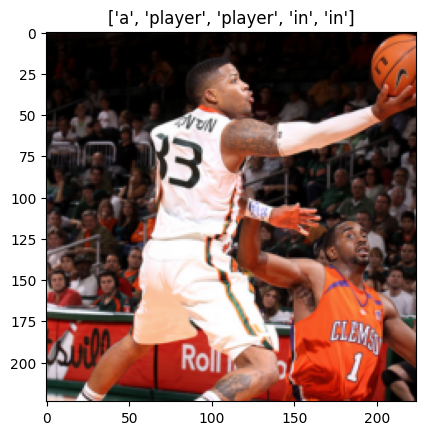


 * LOSS - 3.981, BLEU-4 - 0.03803737780797396

Epoch: [2][0/253]	Batch Time 2.428 (2.428)	Data Load Time 1.782 (1.782)	Loss 4.1063 (4.1063)	
Epoch: [2][100/253]	Batch Time 66.571 (34.669)	Data Load Time 65.943 (34.046)	Loss 3.7197 (3.9158)	
Epoch: [2][200/253]	Batch Time 130.651 (66.658)	Data Load Time 130.047 (66.035)	Loss 3.7062 (3.7979)	
Validation: [0/32]	Batch Time 2.124 (2.124)	Loss 3.3947 (3.3947)	
[['a', 'boy', 'screams', '.']]


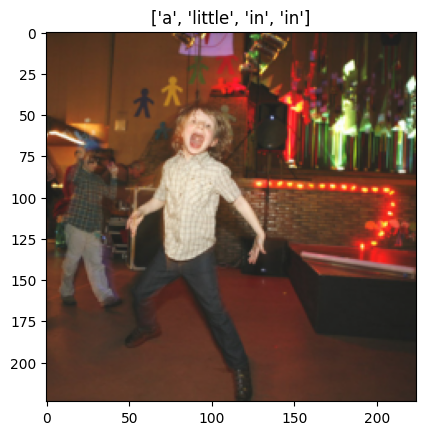


 * LOSS - 3.419, BLEU-4 - 0.0653196547001857

Epoch: [3][0/253]	Batch Time 2.454 (2.454)	Data Load Time 1.789 (1.789)	Loss 3.4064 (3.4064)	
Epoch: [3][100/253]	Batch Time 66.677 (34.632)	Data Load Time 66.061 (34.007)	Loss 3.3919 (3.3997)	
Epoch: [3][200/253]	Batch Time 130.437 (66.571)	Data Load Time 129.813 (65.950)	Loss 3.2122 (3.3608)	
Validation: [0/32]	Batch Time 2.027 (2.027)	Loss 3.2000 (3.2000)	
[['people', 'gather', 'together', 'outdoors', '.']]


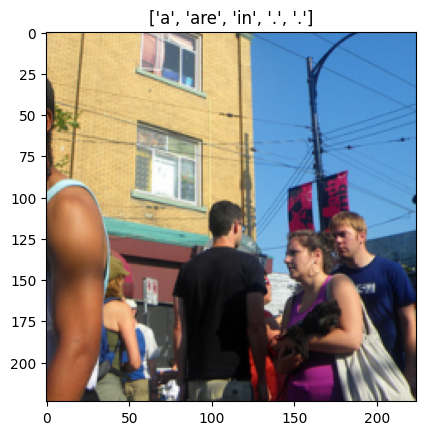


 * LOSS - 3.168, BLEU-4 - 0.07935207288934726

Epoch: [4][0/253]	Batch Time 2.431 (2.431)	Data Load Time 1.746 (1.746)	Loss 3.1069 (3.1069)	
Epoch: [4][100/253]	Batch Time 66.969 (34.817)	Data Load Time 66.330 (34.191)	Loss 3.2698 (3.1316)	
Epoch: [4][200/253]	Batch Time 130.589 (66.789)	Data Load Time 129.972 (66.167)	Loss 2.9534 (3.1039)	
Validation: [0/32]	Batch Time 2.314 (2.314)	Loss 2.9889 (2.9889)	
[['a', 'dog', 'runs']]


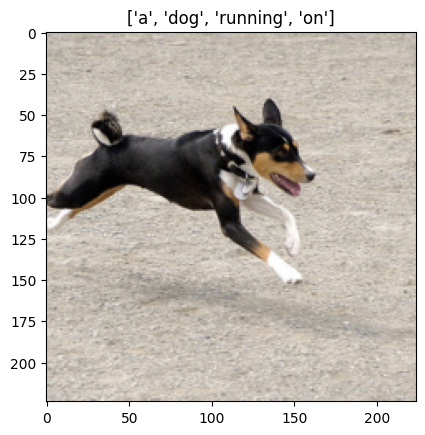


 * LOSS - 3.005, BLEU-4 - 0.09059691204749375

Epoch: [5][0/253]	Batch Time 2.381 (2.381)	Data Load Time 1.759 (1.759)	Loss 2.9608 (2.9608)	
Epoch: [5][100/253]	Batch Time 66.649 (34.586)	Data Load Time 66.002 (33.962)	Loss 3.0840 (2.9311)	
Epoch: [5][200/253]	Batch Time 130.565 (66.586)	Data Load Time 129.961 (65.964)	Loss 2.9344 (2.9181)	
Validation: [0/32]	Batch Time 2.121 (2.121)	Loss 2.9967 (2.9967)	
[['a', 'skier']]


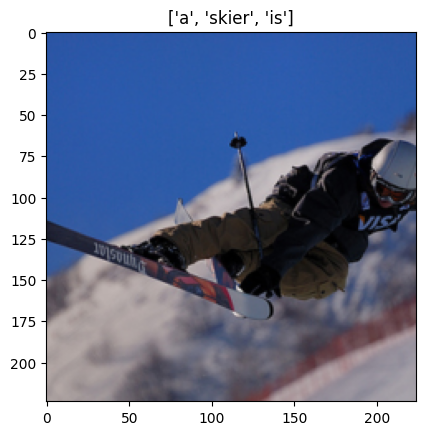


 * LOSS - 2.894, BLEU-4 - 0.09619138091307675

Epoch: [6][0/253]	Batch Time 2.439 (2.439)	Data Load Time 1.744 (1.744)	Loss 2.7679 (2.7679)	
Epoch: [6][100/253]	Batch Time 67.021 (34.869)	Data Load Time 66.403 (34.242)	Loss 2.7272 (2.7734)	
Epoch: [6][200/253]	Batch Time 130.650 (66.820)	Data Load Time 130.047 (66.197)	Loss 2.7353 (2.7635)	
Validation: [0/32]	Batch Time 2.121 (2.121)	Loss 2.9149 (2.9149)	
[['three', 'children', 'playy', 'together', '.']]


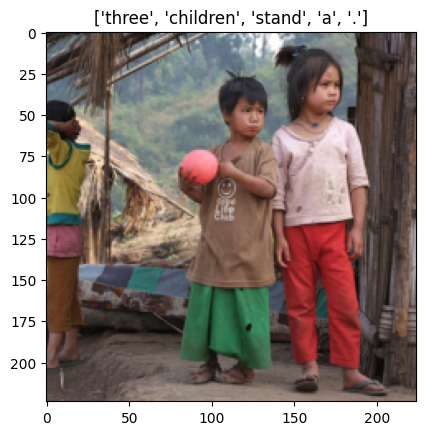


 * LOSS - 2.812, BLEU-4 - 0.10078331030922796

Epoch: [7][0/253]	Batch Time 2.434 (2.434)	Data Load Time 1.783 (1.783)	Loss 2.6263 (2.6263)	
Epoch: [7][100/253]	Batch Time 66.885 (34.773)	Data Load Time 66.277 (34.147)	Loss 2.5105 (2.6393)	
Epoch: [7][200/253]	Batch Time 130.603 (66.713)	Data Load Time 129.979 (66.090)	Loss 2.7017 (2.6452)	
Validation: [0/32]	Batch Time 2.558 (2.558)	Loss 2.7372 (2.7372)	
[['two', 'male', 'spectators']]


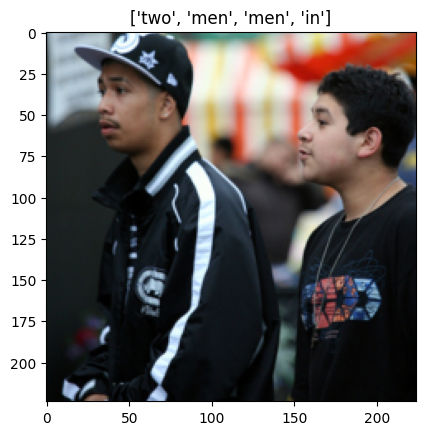


 * LOSS - 2.751, BLEU-4 - 0.10773932426610815

Epoch: [8][0/253]	Batch Time 2.388 (2.388)	Data Load Time 1.747 (1.747)	Loss 2.5963 (2.5963)	
Epoch: [8][100/253]	Batch Time 66.368 (34.518)	Data Load Time 65.754 (33.897)	Loss 2.6175 (2.5311)	
Epoch: [8][200/253]	Batch Time 130.428 (66.469)	Data Load Time 129.801 (65.847)	Loss 2.3862 (2.5313)	
Validation: [0/32]	Batch Time 2.218 (2.218)	Loss 2.8188 (2.8188)	
[['a', 'greyhound', 'racing', '.']]


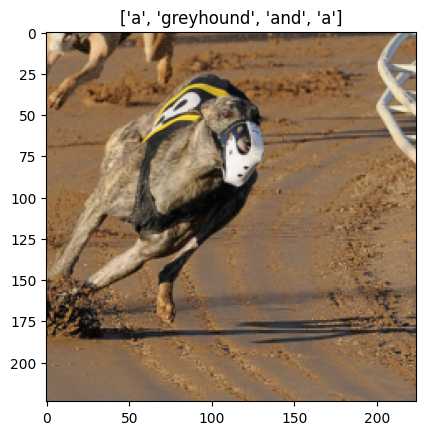


 * LOSS - 2.701, BLEU-4 - 0.10981610686239249

Epoch: [9][0/253]	Batch Time 2.426 (2.426)	Data Load Time 1.783 (1.783)	Loss 2.4987 (2.4987)	
Epoch: [9][100/253]	Batch Time 66.653 (34.639)	Data Load Time 66.003 (34.016)	Loss 2.3944 (2.4325)	
Epoch: [9][200/253]	Batch Time 130.339 (66.538)	Data Load Time 129.731 (65.916)	Loss 2.3696 (2.4411)	
Validation: [0/32]	Batch Time 2.129 (2.129)	Loss 2.6723 (2.6723)	
[['two', 'people', 'standing', 'in', 'the', 'snow']]


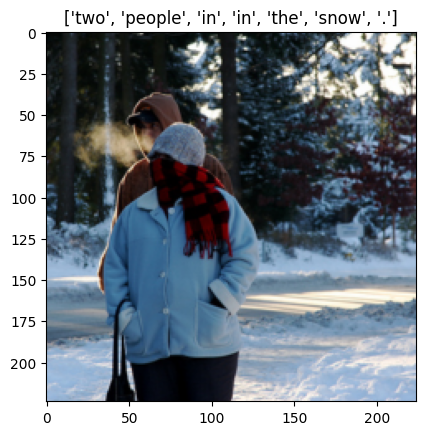


 * LOSS - 2.663, BLEU-4 - 0.11435538516504445

Epoch: [10][0/253]	Batch Time 2.432 (2.432)	Data Load Time 1.767 (1.767)	Loss 2.3532 (2.3532)	
Epoch: [10][100/253]	Batch Time 66.516 (34.690)	Data Load Time 65.893 (34.068)	Loss 2.3400 (2.3377)	
Epoch: [10][200/253]	Batch Time 130.286 (66.584)	Data Load Time 129.675 (65.963)	Loss 2.4576 (2.3541)	
Validation: [0/32]	Batch Time 2.508 (2.508)	Loss 2.4419 (2.4419)	
[['a', 'girl', 'in', 'white', 'dances', '.']]


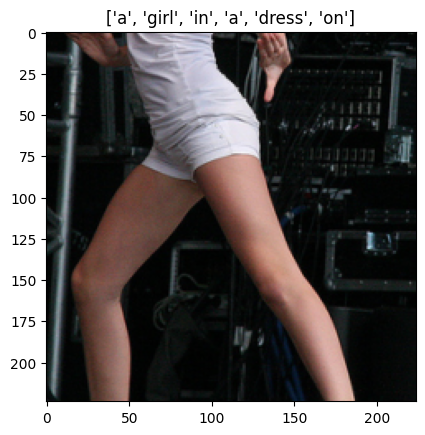


 * LOSS - 2.637, BLEU-4 - 0.11907661027466024

Epoch: [11][0/253]	Batch Time 2.484 (2.484)	Data Load Time 1.804 (1.804)	Loss 2.1658 (2.1658)	
Epoch: [11][100/253]	Batch Time 66.822 (34.846)	Data Load Time 66.219 (34.220)	Loss 2.2369 (2.2709)	
Epoch: [11][200/253]	Batch Time 131.172 (66.948)	Data Load Time 130.538 (66.323)	Loss 2.3441 (2.2748)	
Validation: [0/32]	Batch Time 2.122 (2.122)	Loss 2.5418 (2.5418)	
[['a', 'person', 'wearing', 'a', 'mask', '.']]


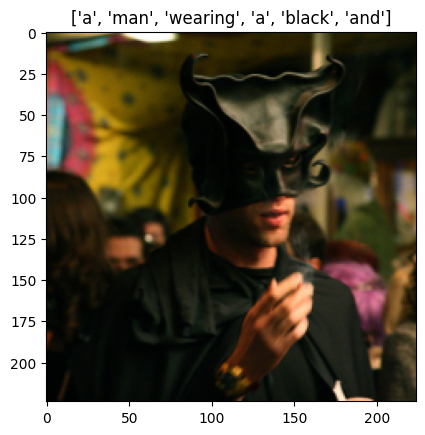


 * LOSS - 2.613, BLEU-4 - 0.11868134501518873


Epochs since last improvement: 1

Epoch: [12][0/253]	Batch Time 2.366 (2.366)	Data Load Time 1.745 (1.745)	Loss 2.2321 (2.2321)	
Epoch: [12][100/253]	Batch Time 66.873 (34.843)	Data Load Time 66.257 (34.217)	Loss 2.1491 (2.1786)	
Epoch: [12][200/253]	Batch Time 131.092 (66.898)	Data Load Time 130.470 (66.274)	Loss 2.0483 (2.1973)	
Validation: [0/32]	Batch Time 2.052 (2.052)	Loss 2.5229 (2.5229)	
[['a', 'greyhound', 'racing', '.']]


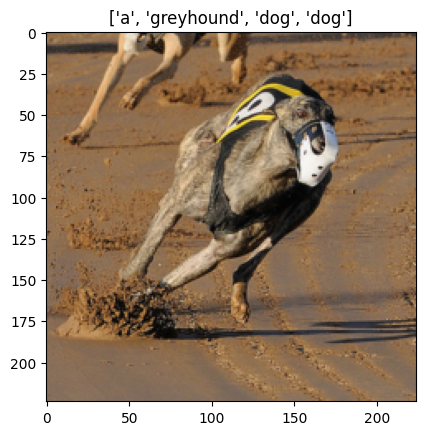


 * LOSS - 2.597, BLEU-4 - 0.12059955873535039

Epoch: [13][0/253]	Batch Time 2.448 (2.448)	Data Load Time 1.770 (1.770)	Loss 2.1103 (2.1103)	
Epoch: [13][100/253]	Batch Time 66.922 (34.857)	Data Load Time 66.286 (34.231)	Loss 2.0955 (2.1161)	
Epoch: [13][200/253]	Batch Time 131.152 (66.949)	Data Load Time 130.449 (66.325)	Loss 2.2284 (2.1332)	
Validation: [0/32]	Batch Time 2.089 (2.089)	Loss 2.5492 (2.5492)	
[['a', 'skier']]


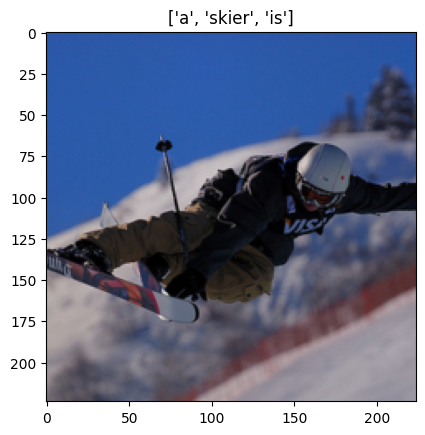


 * LOSS - 2.581, BLEU-4 - 0.12097613508818261

Epoch: [14][0/253]	Batch Time 2.474 (2.474)	Data Load Time 1.770 (1.770)	Loss 1.9932 (1.9932)	
Epoch: [14][100/253]	Batch Time 66.489 (34.518)	Data Load Time 65.863 (33.896)	Loss 2.1150 (2.0376)	
Epoch: [14][200/253]	Batch Time 130.761 (66.600)	Data Load Time 130.134 (65.977)	Loss 2.1063 (2.0673)	
Validation: [0/32]	Batch Time 2.168 (2.168)	Loss 2.5707 (2.5707)	
[['men', 'play', 'field', 'hockey', '.']]


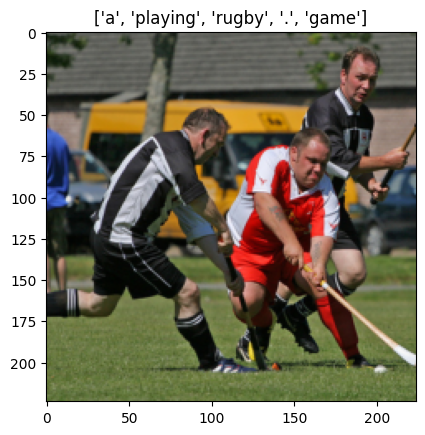


 * LOSS - 2.581, BLEU-4 - 0.1229620500603173

Epoch: [15][0/253]	Batch Time 2.395 (2.395)	Data Load Time 1.716 (1.716)	Loss 1.9035 (1.9035)	
Epoch: [15][100/253]	Batch Time 66.595 (34.582)	Data Load Time 66.036 (33.958)	Loss 1.9751 (1.9911)	
Epoch: [15][200/253]	Batch Time 130.780 (66.637)	Data Load Time 130.133 (66.014)	Loss 2.1298 (2.0052)	
Validation: [0/32]	Batch Time 2.198 (2.198)	Loss 2.5377 (2.5377)	
[['kids', 'playing', 'softball', '.']]


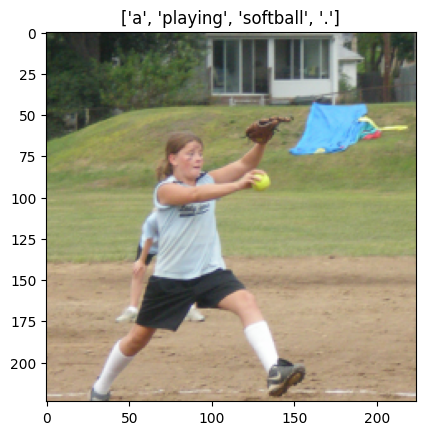


 * LOSS - 2.572, BLEU-4 - 0.12513863120138355

Epoch: [16][0/253]	Batch Time 2.725 (2.725)	Data Load Time 1.977 (1.977)	Loss 1.9258 (1.9258)	
Epoch: [16][100/253]	Batch Time 67.083 (35.003)	Data Load Time 66.455 (34.377)	Loss 2.0478 (1.9290)	
Epoch: [16][200/253]	Batch Time 130.827 (66.949)	Data Load Time 130.208 (66.327)	Loss 1.9896 (1.9484)	
Validation: [0/32]	Batch Time 2.142 (2.142)	Loss 2.8630 (2.8630)	
[['people', 'stand', 'and', 'talk', '.']]


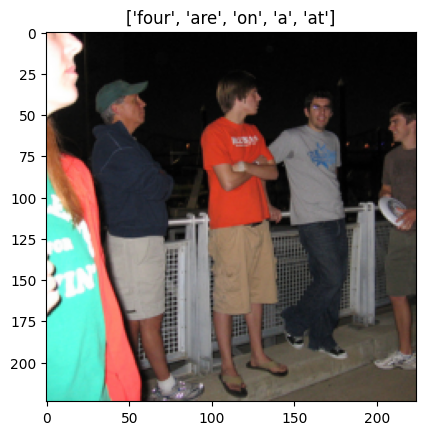


 * LOSS - 2.570, BLEU-4 - 0.1262159829167772

Epoch: [17][0/253]	Batch Time 2.430 (2.430)	Data Load Time 1.758 (1.758)	Loss 1.7713 (1.7713)	
Epoch: [17][100/253]	Batch Time 66.682 (34.687)	Data Load Time 66.057 (34.064)	Loss 1.8677 (1.8847)	
Epoch: [17][200/253]	Batch Time 130.746 (66.748)	Data Load Time 130.142 (66.126)	Loss 1.9159 (1.8975)	
Validation: [0/32]	Batch Time 2.087 (2.087)	Loss 2.4673 (2.4673)	
[['a', 'climber', 'ascending', 'a', 'mountain']]


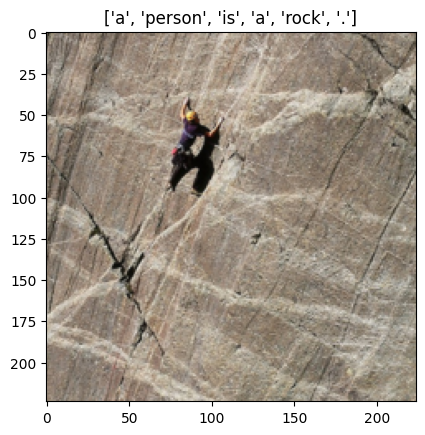


 * LOSS - 2.575, BLEU-4 - 0.12501712100148166


Epochs since last improvement: 1

Epoch: [18][0/253]	Batch Time 2.480 (2.480)	Data Load Time 1.776 (1.776)	Loss 1.7930 (1.7930)	
Epoch: [18][100/253]	Batch Time 66.746 (34.652)	Data Load Time 66.123 (34.028)	Loss 1.8627 (1.8275)	
Epoch: [18][200/253]	Batch Time 130.610 (66.666)	Data Load Time 129.995 (66.044)	Loss 1.8759 (1.8460)	
Validation: [0/32]	Batch Time 2.075 (2.075)	Loss 2.3939 (2.3939)	
[['skiers', 'are', 'competing', '.']]


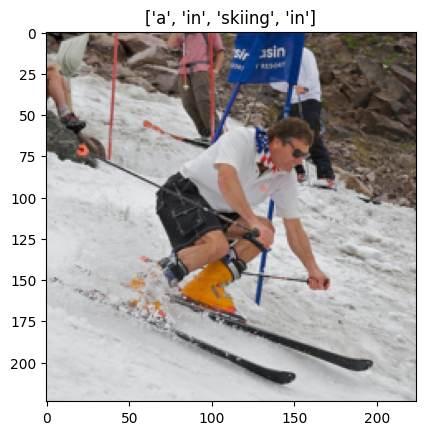


 * LOSS - 2.581, BLEU-4 - 0.12514721445767507


Epochs since last improvement: 2

Epoch: [19][0/253]	Batch Time 2.878 (2.878)	Data Load Time 2.164 (2.164)	Loss 1.7906 (1.7906)	
Epoch: [19][100/253]	Batch Time 67.019 (35.139)	Data Load Time 66.405 (34.515)	Loss 1.8534 (1.7871)	
Epoch: [19][200/253]	Batch Time 130.999 (67.044)	Data Load Time 130.383 (66.422)	Loss 1.8914 (1.8014)	
Validation: [0/32]	Batch Time 2.097 (2.097)	Loss 2.5143 (2.5143)	
[['a', 'man', 'water', 'boarding', '.']]


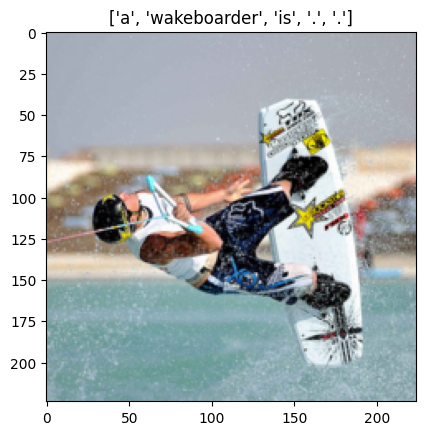


 * LOSS - 2.579, BLEU-4 - 0.12622196990514226

Epoch: [20][0/253]	Batch Time 2.515 (2.515)	Data Load Time 1.868 (1.868)	Loss 1.6609 (1.6609)	
Epoch: [20][100/253]	Batch Time 66.719 (34.603)	Data Load Time 66.111 (33.979)	Loss 1.8285 (1.7382)	
Epoch: [20][200/253]	Batch Time 130.790 (66.674)	Data Load Time 130.167 (66.051)	Loss 1.7622 (1.7580)	
Validation: [0/32]	Batch Time 2.171 (2.171)	Loss 2.6592 (2.6592)	
[['three', 'children', 'playy', 'together', '.']]


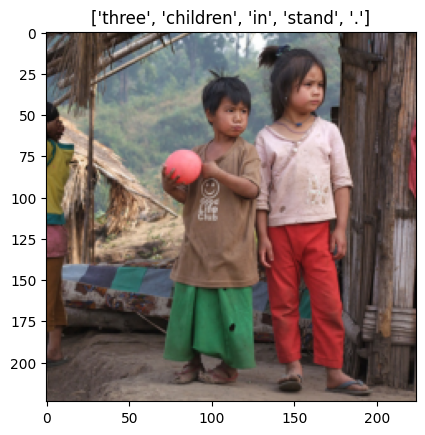


 * LOSS - 2.578, BLEU-4 - 0.13004507178385613

Epoch: [21][0/253]	Batch Time 2.396 (2.396)	Data Load Time 1.768 (1.768)	Loss 1.5997 (1.5997)	
Epoch: [21][100/253]	Batch Time 66.594 (34.661)	Data Load Time 65.974 (34.037)	Loss 1.6895 (1.6863)	
Epoch: [21][200/253]	Batch Time 130.617 (66.601)	Data Load Time 129.921 (65.979)	Loss 1.7107 (1.7103)	
Validation: [0/32]	Batch Time 2.117 (2.117)	Loss 2.4858 (2.4858)	
[['five', 'men', 'play', 'football', '.']]


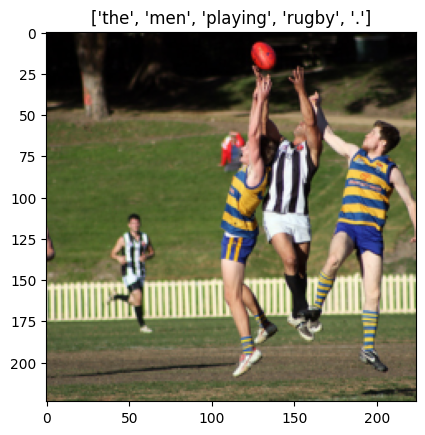


 * LOSS - 2.596, BLEU-4 - 0.12636085251817064


Epochs since last improvement: 1

Epoch: [22][0/253]	Batch Time 2.452 (2.452)	Data Load Time 1.793 (1.793)	Loss 1.6479 (1.6479)	
Epoch: [22][100/253]	Batch Time 66.958 (34.871)	Data Load Time 66.397 (34.246)	Loss 1.6931 (1.6424)	
Epoch: [22][200/253]	Batch Time 131.102 (66.948)	Data Load Time 130.482 (66.324)	Loss 1.6584 (1.6645)	
Validation: [0/32]	Batch Time 2.153 (2.153)	Loss 2.5201 (2.5201)	
[['a', 'boy', 'screams', '.']]


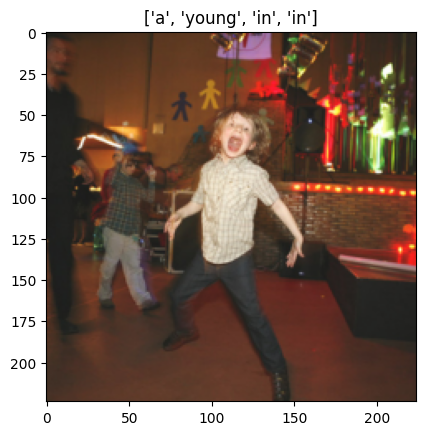


 * LOSS - 2.600, BLEU-4 - 0.1258299940111509


Epochs since last improvement: 2

Epoch: [23][0/253]	Batch Time 2.370 (2.370)	Data Load Time 1.741 (1.741)	Loss 1.6533 (1.6533)	
Epoch: [23][100/253]	Batch Time 66.848 (34.731)	Data Load Time 66.240 (34.105)	Loss 1.6092 (1.6033)	
Epoch: [23][200/253]	Batch Time 130.893 (66.822)	Data Load Time 130.259 (66.198)	Loss 1.7516 (1.6232)	
Validation: [0/32]	Batch Time 2.085 (2.085)	Loss 2.6895 (2.6895)	
[['a', 'snowboarder', 'jumping', '.']]


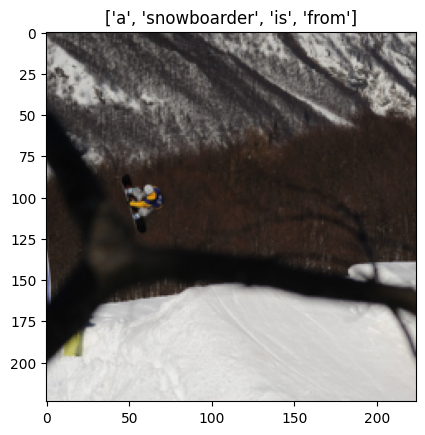


 * LOSS - 2.615, BLEU-4 - 0.12719487704984395


Epochs since last improvement: 3

Epoch: [24][0/253]	Batch Time 2.500 (2.500)	Data Load Time 1.796 (1.796)	Loss 1.5915 (1.5915)	
Epoch: [24][100/253]	Batch Time 66.769 (34.760)	Data Load Time 66.214 (34.136)	Loss 1.4403 (1.5679)	
Epoch: [24][200/253]	Batch Time 130.931 (66.805)	Data Load Time 130.327 (66.182)	Loss 1.5689 (1.5876)	
Validation: [0/32]	Batch Time 2.042 (2.042)	Loss 2.5575 (2.5575)	
[['two', 'soccer', 'teams', 'compete', '.']]


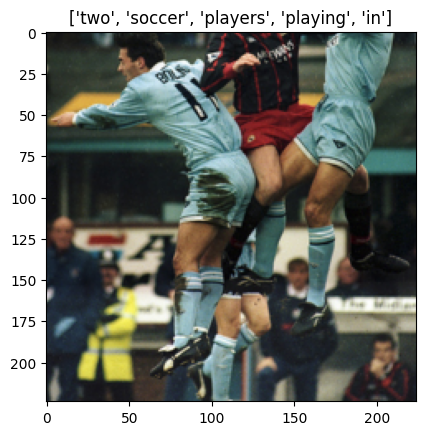


 * LOSS - 2.620, BLEU-4 - 0.12596721441865177


Epochs since last improvement: 4

Epoch: [25][0/253]	Batch Time 2.455 (2.455)	Data Load Time 1.795 (1.795)	Loss 1.5188 (1.5188)	
Epoch: [25][100/253]	Batch Time 66.899 (34.725)	Data Load Time 66.267 (34.099)	Loss 1.5826 (1.5302)	
Epoch: [25][200/253]	Batch Time 130.963 (66.825)	Data Load Time 130.337 (66.202)	Loss 1.5734 (1.5531)	
Validation: [0/32]	Batch Time 2.099 (2.099)	Loss 2.6462 (2.6462)	
[['a', 'climber', 'ascending', 'a', 'mountain']]


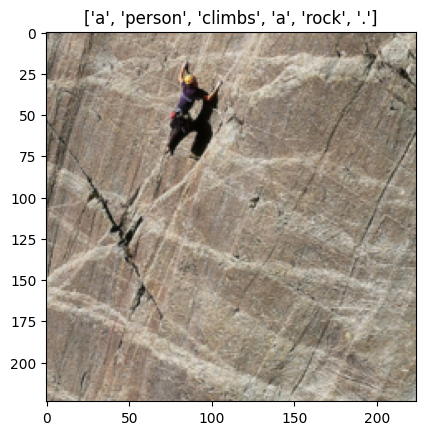


 * LOSS - 2.632, BLEU-4 - 0.12590136236338034


Epochs since last improvement: 5

Epoch: [26][0/253]	Batch Time 2.494 (2.494)	Data Load Time 1.861 (1.861)	Loss 1.4900 (1.4900)	
Epoch: [26][100/253]	Batch Time 66.871 (34.688)	Data Load Time 66.253 (34.063)	Loss 1.4469 (1.4997)	
Epoch: [26][200/253]	Batch Time 130.591 (66.754)	Data Load Time 129.976 (66.133)	Loss 1.6041 (1.5194)	
Validation: [0/32]	Batch Time 2.152 (2.152)	Loss 2.5356 (2.5356)	
[['two', 'soccer', 'teams', 'compete', '.']]


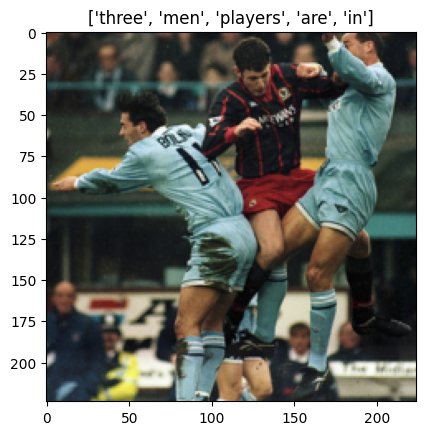


 * LOSS - 2.647, BLEU-4 - 0.1259920031634482


Epochs since last improvement: 6

Epoch: [27][0/253]	Batch Time 2.380 (2.380)	Data Load Time 1.746 (1.746)	Loss 1.4452 (1.4452)	
Epoch: [27][100/253]	Batch Time 66.522 (34.544)	Data Load Time 65.888 (33.922)	Loss 1.5076 (1.4622)	
Epoch: [27][200/253]	Batch Time 130.708 (66.569)	Data Load Time 130.088 (65.947)	Loss 1.5034 (1.4845)	
Validation: [0/32]	Batch Time 2.127 (2.127)	Loss 2.7007 (2.7007)	
[['two', 'people', 'rock', 'climbing', '.']]


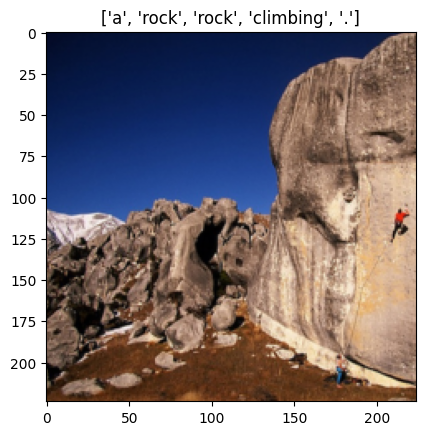


 * LOSS - 2.659, BLEU-4 - 0.12744817414622775


Epochs since last improvement: 7

Epoch: [28][0/253]	Batch Time 2.432 (2.432)	Data Load Time 1.755 (1.755)	Loss 1.3935 (1.3935)	
Epoch: [28][100/253]	Batch Time 66.867 (34.703)	Data Load Time 66.232 (34.077)	Loss 1.4724 (1.4337)	
Epoch: [28][200/253]	Batch Time 130.925 (66.832)	Data Load Time 130.289 (66.208)	Loss 1.5436 (1.4524)	
Validation: [0/32]	Batch Time 2.135 (2.135)	Loss 2.8066 (2.8066)	
[['a', 'boy', 'skateboarding']]


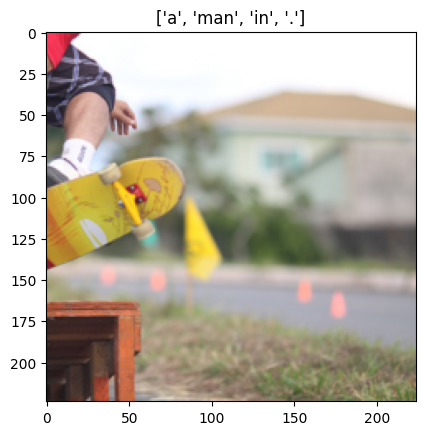


 * LOSS - 2.669, BLEU-4 - 0.1284748346903103


Epochs since last improvement: 8


DECAYING learning rate.
The new learning rate is 0.000240


DECAYING learning rate.
The new learning rate is 0.000080

Epoch: [29][0/253]	Batch Time 2.465 (2.465)	Data Load Time 1.813 (1.813)	Loss 1.4776 (1.4776)	
Epoch: [29][100/253]	Batch Time 66.977 (34.890)	Data Load Time 66.342 (34.264)	Loss 1.4399 (1.3831)	
Epoch: [29][200/253]	Batch Time 131.077 (66.953)	Data Load Time 130.432 (66.329)	Loss 1.4679 (1.4010)	
Validation: [0/32]	Batch Time 2.545 (2.545)	Loss 2.8427 (2.8427)	
[['two', 'bikers', 'race', 'uphill', '.']]


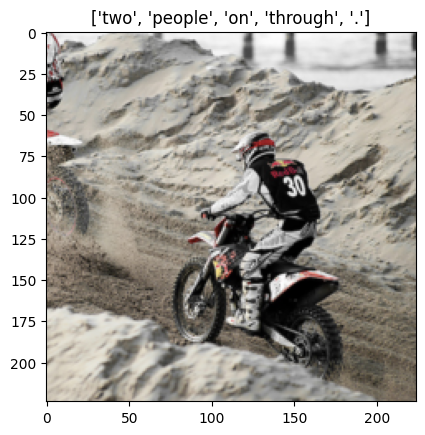


 * LOSS - 2.687, BLEU-4 - 0.12494995827901725


Epochs since last improvement: 9

Epoch: [30][0/253]	Batch Time 2.467 (2.467)	Data Load Time 1.803 (1.803)	Loss 1.3835 (1.3835)	
Epoch: [30][100/253]	Batch Time 67.088 (34.916)	Data Load Time 66.437 (34.288)	Loss 1.3273 (1.3566)	
Epoch: [30][200/253]	Batch Time 131.064 (67.014)	Data Load Time 130.454 (66.390)	Loss 1.4435 (1.3676)	
Validation: [0/32]	Batch Time 2.071 (2.071)	Loss 2.6590 (2.6590)	
[['a', 'family', 'in', 'the', 'desert', '.']]


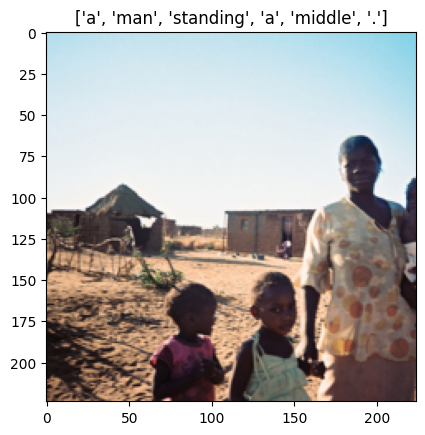


 * LOSS - 2.705, BLEU-4 - 0.12483068684498762


Epochs since last improvement: 10

Epoch: [31][0/253]	Batch Time 2.470 (2.470)	Data Load Time 1.847 (1.847)	Loss 1.2609 (1.2609)	
Epoch: [31][100/253]	Batch Time 66.960 (34.872)	Data Load Time 66.299 (34.246)	Loss 1.3741 (1.3189)	
Epoch: [31][200/253]	Batch Time 130.892 (66.883)	Data Load Time 130.280 (66.260)	Loss 1.3107 (1.3408)	
Validation: [0/32]	Batch Time 2.175 (2.175)	Loss 2.6257 (2.6257)	
[['a', 'greyhound', 'racing', '.']]


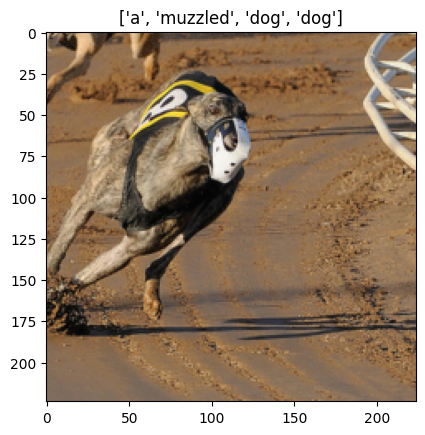


 * LOSS - 2.722, BLEU-4 - 0.12372136395176067


Epochs since last improvement: 11

Epoch: [32][0/253]	Batch Time 2.479 (2.479)	Data Load Time 1.833 (1.833)	Loss 1.2690 (1.2690)	
Epoch: [32][100/253]	Batch Time 67.053 (34.944)	Data Load Time 66.437 (34.318)	Loss 1.3642 (1.2949)	
Epoch: [32][200/253]	Batch Time 131.456 (67.116)	Data Load Time 130.820 (66.491)	Loss 1.4222 (1.3157)	
Validation: [0/32]	Batch Time 2.115 (2.115)	Loss 2.8258 (2.8258)	
[['dog', 'in', 'air']]


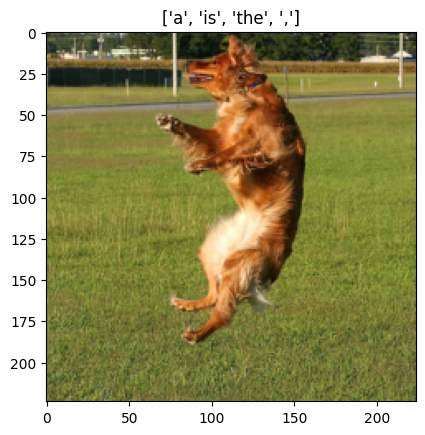


 * LOSS - 2.748, BLEU-4 - 0.12315286737431404


Epochs since last improvement: 12

Epoch: [33][0/253]	Batch Time 2.428 (2.428)	Data Load Time 1.782 (1.782)	Loss 1.2202 (1.2202)	
Epoch: [33][100/253]	Batch Time 66.725 (34.719)	Data Load Time 66.109 (34.094)	Loss 1.2839 (1.2658)	
Epoch: [33][200/253]	Batch Time 130.929 (66.807)	Data Load Time 130.287 (66.184)	Loss 1.3516 (1.2916)	
Validation: [0/32]	Batch Time 2.110 (2.110)	Loss 2.8871 (2.8871)	
[['people', 'sit', 'on', 'benches', '.']]


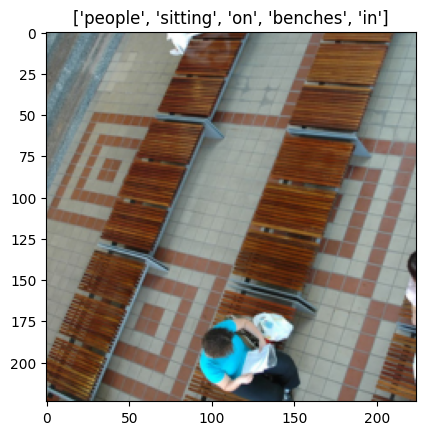


 * LOSS - 2.759, BLEU-4 - 0.12436506769480042


Epochs since last improvement: 13

Epoch: [34][0/253]	Batch Time 2.485 (2.485)	Data Load Time 1.756 (1.756)	Loss 1.1645 (1.1645)	
Epoch: [34][100/253]	Batch Time 66.740 (34.657)	Data Load Time 66.129 (34.032)	Loss 1.2377 (1.2465)	
Epoch: [34][200/253]	Batch Time 130.836 (66.729)	Data Load Time 130.222 (66.105)	Loss 1.2820 (1.2678)	
Validation: [0/32]	Batch Time 2.093 (2.093)	Loss 2.8446 (2.8446)	
[['a', 'climber', 'ascending', 'a', 'mountain']]


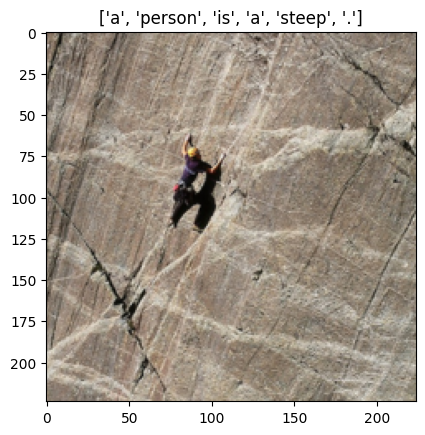


 * LOSS - 2.768, BLEU-4 - 0.12559789618470982


Epochs since last improvement: 14

Epoch: [35][0/253]	Batch Time 2.434 (2.434)	Data Load Time 1.702 (1.702)	Loss 1.2158 (1.2158)	
Epoch: [35][100/253]	Batch Time 66.884 (34.778)	Data Load Time 66.271 (34.152)	Loss 1.2573 (1.2283)	
Epoch: [35][200/253]	Batch Time 131.302 (66.985)	Data Load Time 130.678 (66.359)	Loss 1.3158 (1.2461)	
Validation: [0/32]	Batch Time 2.139 (2.139)	Loss 2.7917 (2.7917)	
[['a', 'greyhound', 'racing', '.']]


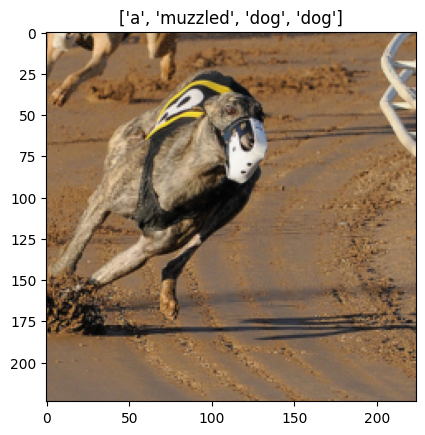


 * LOSS - 2.794, BLEU-4 - 0.12391036187480337


Epochs since last improvement: 15

Epoch: [36][0/253]	Batch Time 2.366 (2.366)	Data Load Time 1.682 (1.682)	Loss 1.2346 (1.2346)	
Epoch: [36][100/253]	Batch Time 66.452 (34.634)	Data Load Time 65.831 (34.012)	Loss 1.2609 (1.2000)	
Epoch: [36][200/253]	Batch Time 130.522 (66.500)	Data Load Time 129.851 (65.878)	Loss 1.2823 (1.2213)	
Validation: [0/32]	Batch Time 2.249 (2.249)	Loss 2.7933 (2.7933)	
[['a', 'rock', 'climber', 'ascends', '.']]


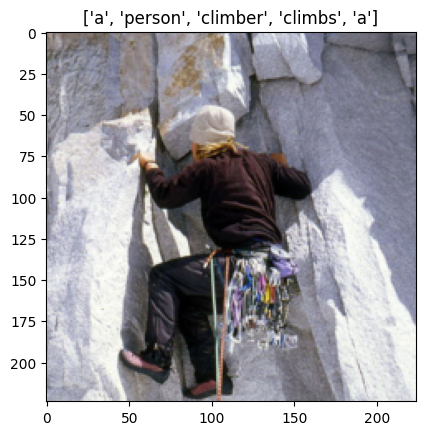


 * LOSS - 2.798, BLEU-4 - 0.12367827727733273


Epochs since last improvement: 16


DECAYING learning rate.
The new learning rate is 0.000192


DECAYING learning rate.
The new learning rate is 0.000064

Epoch: [37][0/253]	Batch Time 2.451 (2.451)	Data Load Time 1.778 (1.778)	Loss 1.1228 (1.1228)	
Epoch: [37][100/253]	Batch Time 66.993 (34.763)	Data Load Time 66.377 (34.137)	Loss 1.2090 (1.1708)	
Epoch: [37][200/253]	Batch Time 131.028 (66.841)	Data Load Time 130.420 (66.217)	Loss 1.2427 (1.1857)	
Validation: [0/32]	Batch Time 2.047 (2.047)	Loss 2.8726 (2.8726)	
[['fast', 'paced', 'basketball', 'action']]


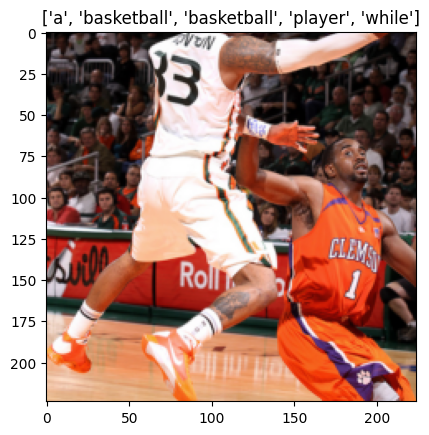


 * LOSS - 2.834, BLEU-4 - 0.12455332149200375


Epochs since last improvement: 17

Epoch: [38][0/253]	Batch Time 2.415 (2.415)	Data Load Time 1.740 (1.740)	Loss 1.2052 (1.2052)	
Epoch: [38][100/253]	Batch Time 67.124 (34.942)	Data Load Time 66.469 (34.314)	Loss 1.1980 (1.1461)	
Epoch: [38][200/253]	Batch Time 131.110 (67.078)	Data Load Time 130.508 (66.454)	Loss 1.2327 (1.1627)	
Validation: [0/32]	Batch Time 2.061 (2.061)	Loss 2.7892 (2.7892)	
[['three', 'children', 'playy', 'together', '.']]


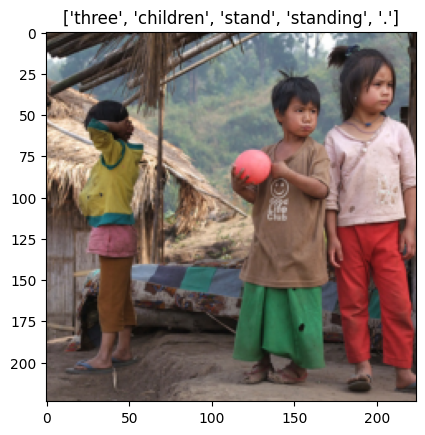


 * LOSS - 2.843, BLEU-4 - 0.12161830296284687


Epochs since last improvement: 18

Epoch: [39][0/253]	Batch Time 2.441 (2.441)	Data Load Time 1.792 (1.792)	Loss 1.1012 (1.1012)	
Epoch: [39][100/253]	Batch Time 66.647 (34.593)	Data Load Time 66.017 (33.970)	Loss 1.1663 (1.1263)	
Epoch: [39][200/253]	Batch Time 130.753 (66.673)	Data Load Time 130.142 (66.050)	Loss 1.1568 (1.1407)	
Validation: [0/32]	Batch Time 2.121 (2.121)	Loss 2.8731 (2.8731)	
[['four', 'people', 'posing', 'for', 'a', 'picture']]


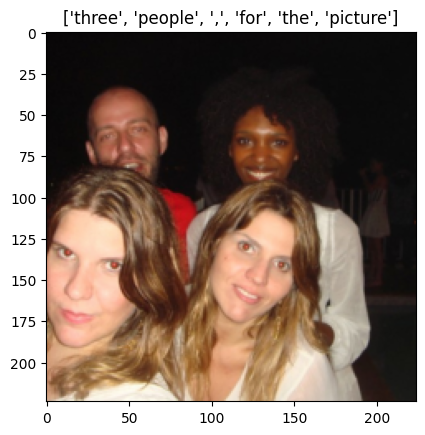


 * LOSS - 2.868, BLEU-4 - 0.1212657521777324


Epochs since last improvement: 19

Epoch: [40][0/253]	Batch Time 2.384 (2.384)	Data Load Time 1.742 (1.742)	Loss 1.0269 (1.0269)	
Epoch: [40][100/253]	Batch Time 66.759 (34.633)	Data Load Time 66.135 (34.008)	Loss 1.1025 (1.1084)	
Epoch: [40][200/253]	Batch Time 130.842 (66.686)	Data Load Time 130.219 (66.063)	Loss 1.1308 (1.1199)	
Validation: [0/32]	Batch Time 2.009 (2.009)	Loss 2.8974 (2.8974)	
[['performers', 'performing', 'a', 'play', '.']]


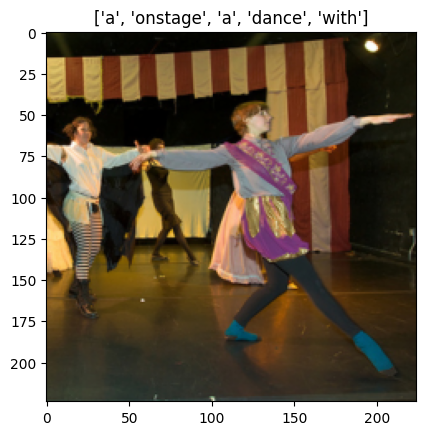


 * LOSS - 2.882, BLEU-4 - 0.12091268630673414


Epochs since last improvement: 20



In [44]:
for epoch in range(start_epoch, epochs):
    # Decay learning rate if there is no improvement for 8 consecutive epochs, and terminate training after 20
    if epochs_since_improvement == 20:
        break
    if epochs_since_improvement > 0 and epochs_since_improvement % 8 == 0:
        adjust_learning_rate(decoder_noAtt_optimizer, 0.8)
        if fine_tune_encoder:
            adjust_learning_rate(encoder_noAtt_optimizer, 0.8)

    # One epoch's training
    train(train_loader= train_loader,
          encoder=encoder_noAtt,
          decoder=decoder_noAtt,
          criterion=criterion_noAtt,
          encoder_optimizer=encoder_noAtt_optimizer,
          decoder_optimizer=decoder_noAtt_optimizer,
          epoch=epoch,
          attention = False)

    # One epoch's validation
    recent_bleu4 = validate(val_loader = val_loader,
                            encoder=encoder_noAtt,
                            decoder=decoder_noAtt,
                            criterion=criterion_noAtt,
                            attention = False)

    # Check if there was an improvement
    is_best = recent_bleu4 > best_bleu4
    best_bleu4 = max(recent_bleu4, best_bleu4)
    if not is_best:
        epochs_since_improvement += 1
        print("\nEpochs since last improvement: %d\n" % (epochs_since_improvement,))
    else:
        epochs_since_improvement = 0

    save_checkpoint(data_name, epoch, epochs_since_improvement, encoder, decoder, encoder_optimizer,
                        decoder_optimizer, recent_bleu4, is_best)


# Train model with attention

In [45]:
epochs_since_improvement = 0
start_epoch = 1
epochs = 100
best_bleu4 = 0
data_name = 'attention_model_state'

## Train and Save

Epoch: [1][0/253]	Batch Time 2.832 (2.832)	Data Load Time 1.805 (1.805)	Loss 9.9312 (9.9312)	
Epoch: [1][100/253]	Batch Time 95.585 (49.150)	Data Load Time 94.698 (48.240)	Loss 5.4745 (6.4157)	
Epoch: [1][200/253]	Batch Time 187.960 (95.400)	Data Load Time 187.071 (94.492)	Loss 5.0590 (5.8581)	
Validation: [0/32]	Batch Time 2.179 (2.179)	Loss 4.7494 (4.7494)	
[['two', 'male', 'spectators']]


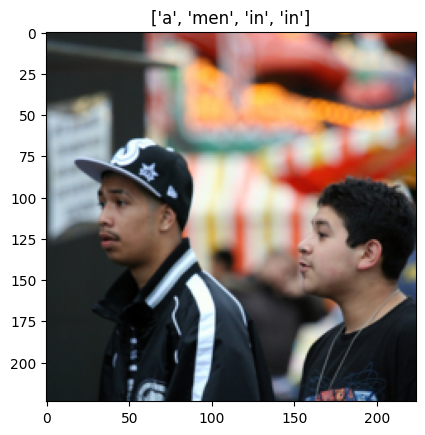


 * LOSS - 4.710, BLEU-4 - 0.04729388680872481

Epoch: [2][0/253]	Batch Time 2.651 (2.651)	Data Load Time 1.729 (1.729)	Loss 4.7499 (4.7499)	
Epoch: [2][100/253]	Batch Time 94.648 (48.783)	Data Load Time 93.774 (47.881)	Loss 4.4876 (4.6518)	
Epoch: [2][200/253]	Batch Time 187.189 (94.851)	Data Load Time 186.267 (93.946)	Loss 4.3241 (4.5378)	
Validation: [0/32]	Batch Time 2.304 (2.304)	Loss 4.1886 (4.1886)	
[['a', 'bird', 'eating', '.']]


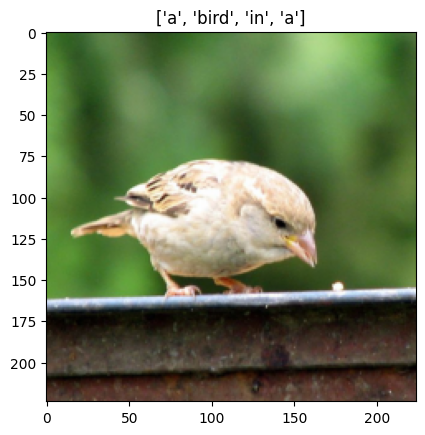


 * LOSS - 4.175, BLEU-4 - 0.07705679713964975

Epoch: [3][0/253]	Batch Time 2.629 (2.629)	Data Load Time 1.684 (1.684)	Loss 4.1393 (4.1393)	
Epoch: [3][100/253]	Batch Time 95.393 (49.180)	Data Load Time 94.514 (48.270)	Loss 4.0012 (4.1291)	
Epoch: [3][200/253]	Batch Time 187.610 (95.299)	Data Load Time 186.717 (94.392)	Loss 3.9619 (4.0973)	
Validation: [0/32]	Batch Time 2.281 (2.281)	Loss 3.8638 (3.8638)	
[['black', 'dog', 'running', 'across', 'sand', '.']]


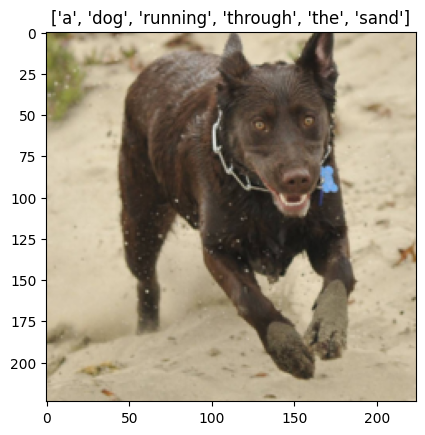


 * LOSS - 3.930, BLEU-4 - 0.09136790294004551

Epoch: [4][0/253]	Batch Time 2.722 (2.722)	Data Load Time 1.768 (1.768)	Loss 3.8910 (3.8910)	
Epoch: [4][100/253]	Batch Time 95.541 (49.256)	Data Load Time 94.715 (48.346)	Loss 3.8778 (3.8530)	
Epoch: [4][200/253]	Batch Time 187.680 (95.434)	Data Load Time 186.796 (94.527)	Loss 3.7494 (3.8328)	
Validation: [0/32]	Batch Time 2.125 (2.125)	Loss 3.8611 (3.8611)	
[['three', 'boys', 'playing', 'soccer', '.']]


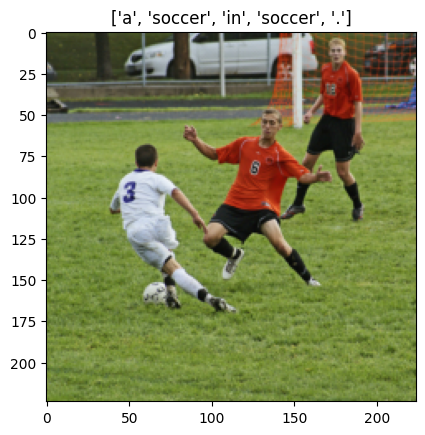


 * LOSS - 3.784, BLEU-4 - 0.10253110848716282

Epoch: [5][0/253]	Batch Time 2.685 (2.685)	Data Load Time 1.745 (1.745)	Loss 3.6843 (3.6843)	
Epoch: [5][100/253]	Batch Time 95.126 (49.000)	Data Load Time 94.256 (48.094)	Loss 3.5550 (3.6427)	
Epoch: [5][200/253]	Batch Time 188.170 (95.261)	Data Load Time 187.220 (94.352)	Loss 3.5567 (3.6322)	
Validation: [0/32]	Batch Time 2.125 (2.125)	Loss 3.5438 (3.5438)	
[['a', 'woman', 'jogger', '.']]


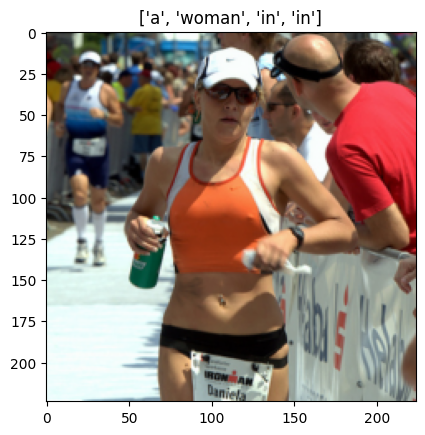


 * LOSS - 3.681, BLEU-4 - 0.10617106601471785

Epoch: [6][0/253]	Batch Time 2.736 (2.736)	Data Load Time 1.777 (1.777)	Loss 3.3000 (3.3000)	
Epoch: [6][100/253]	Batch Time 95.734 (49.338)	Data Load Time 94.821 (48.427)	Loss 3.5501 (3.4645)	
Epoch: [6][200/253]	Batch Time 188.220 (95.684)	Data Load Time 187.328 (94.775)	Loss 3.3684 (3.4658)	
Validation: [0/32]	Batch Time 2.180 (2.180)	Loss 3.6493 (3.6493)	
[['a', 'baseball', 'player', 'punting', '.']]


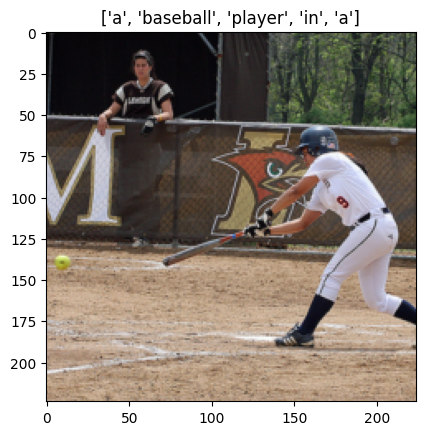


 * LOSS - 3.604, BLEU-4 - 0.11249190915913744

Epoch: [7][0/253]	Batch Time 2.769 (2.769)	Data Load Time 1.766 (1.766)	Loss 3.3348 (3.3348)	
Epoch: [7][100/253]	Batch Time 95.495 (49.281)	Data Load Time 94.587 (48.371)	Loss 3.4421 (3.3191)	
Epoch: [7][200/253]	Batch Time 187.963 (95.529)	Data Load Time 187.024 (94.621)	Loss 3.3512 (3.3284)	
Validation: [0/32]	Batch Time 2.174 (2.174)	Loss 3.7643 (3.7643)	
[['two', 'men', 'wearing', 'sunglasses', '.']]


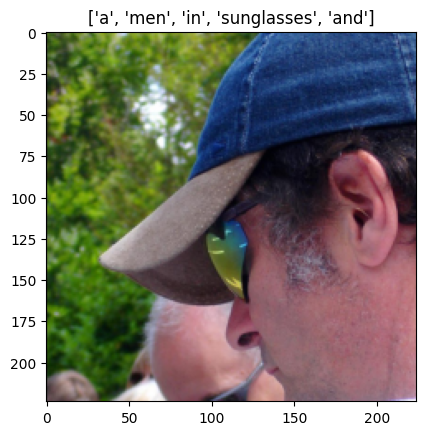


 * LOSS - 3.553, BLEU-4 - 0.11706385335667581

Epoch: [8][0/253]	Batch Time 2.646 (2.646)	Data Load Time 1.680 (1.680)	Loss 3.1616 (3.1616)	
Epoch: [8][100/253]	Batch Time 95.111 (48.928)	Data Load Time 94.234 (48.022)	Loss 3.1318 (3.1878)	
Epoch: [8][200/253]	Batch Time 186.998 (94.979)	Data Load Time 186.060 (94.076)	Loss 3.1730 (3.1982)	
Validation: [0/32]	Batch Time 2.170 (2.170)	Loss 3.4933 (3.4933)	
[['dog', 'running', 'in', 'field']]


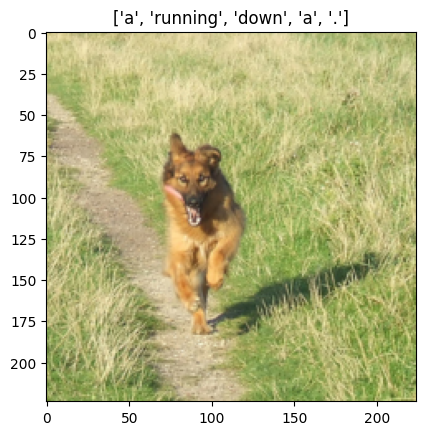


 * LOSS - 3.518, BLEU-4 - 0.1183384685541133

Epoch: [9][0/253]	Batch Time 3.053 (3.053)	Data Load Time 2.019 (2.019)	Loss 3.1872 (3.1872)	
Epoch: [9][100/253]	Batch Time 95.768 (49.378)	Data Load Time 94.866 (48.468)	Loss 3.1678 (3.0821)	
Epoch: [9][200/253]	Batch Time 188.632 (95.785)	Data Load Time 187.722 (94.876)	Loss 3.1222 (3.0933)	
Validation: [0/32]	Batch Time 2.190 (2.190)	Loss 3.4041 (3.4041)	
[['four', 'people', 'in', 'a', 'kitchen']]


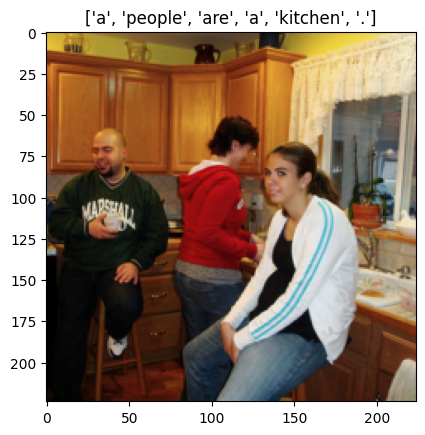


 * LOSS - 3.488, BLEU-4 - 0.1228526260075238

Epoch: [10][0/253]	Batch Time 2.823 (2.823)	Data Load Time 1.851 (1.851)	Loss 3.0115 (3.0115)	
Epoch: [10][100/253]	Batch Time 95.648 (49.094)	Data Load Time 94.746 (48.184)	Loss 3.0582 (2.9837)	
Epoch: [10][200/253]	Batch Time 188.155 (95.518)	Data Load Time 187.235 (94.610)	Loss 3.0013 (2.9943)	
Validation: [0/32]	Batch Time 2.302 (2.302)	Loss 3.4265 (3.4265)	
[['dirt', 'biker', 'taking', 'a', 'corner']]


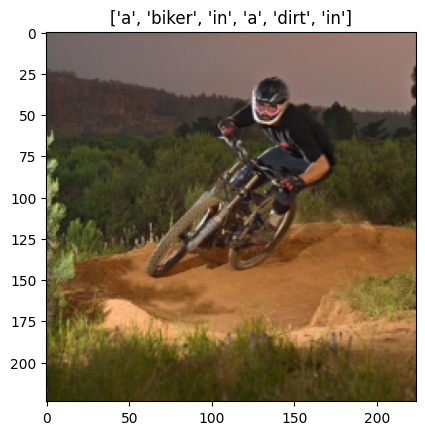


 * LOSS - 3.471, BLEU-4 - 0.12304425413275481

Epoch: [11][0/253]	Batch Time 2.758 (2.758)	Data Load Time 1.864 (1.864)	Loss 2.7785 (2.7785)	
Epoch: [11][100/253]	Batch Time 95.850 (49.399)	Data Load Time 94.927 (48.487)	Loss 2.8676 (2.8914)	
Epoch: [11][200/253]	Batch Time 188.213 (95.694)	Data Load Time 187.331 (94.786)	Loss 2.9292 (2.9028)	
Validation: [0/32]	Batch Time 2.168 (2.168)	Loss 3.6230 (3.6230)	
[['a', 'band', 'in', 'the', 'studio']]


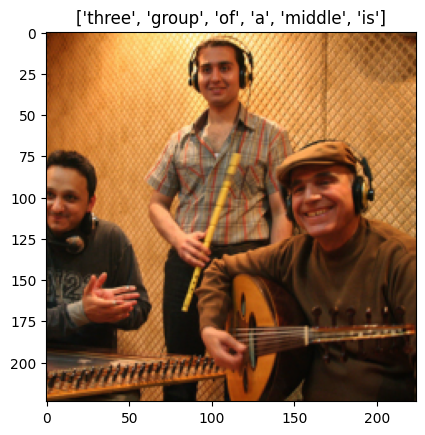


 * LOSS - 3.453, BLEU-4 - 0.12702945835254684

Epoch: [12][0/253]	Batch Time 2.658 (2.658)	Data Load Time 1.773 (1.773)	Loss 2.7150 (2.7150)	
Epoch: [12][100/253]	Batch Time 95.566 (49.219)	Data Load Time 94.664 (48.310)	Loss 2.7947 (2.7978)	
Epoch: [12][200/253]	Batch Time 188.285 (95.550)	Data Load Time 187.396 (94.641)	Loss 2.9244 (2.8168)	
Validation: [0/32]	Batch Time 2.180 (2.180)	Loss 3.3305 (3.3305)	
[['a', 'skateboarder', 'grinds', 'the', 'rail', '.']]


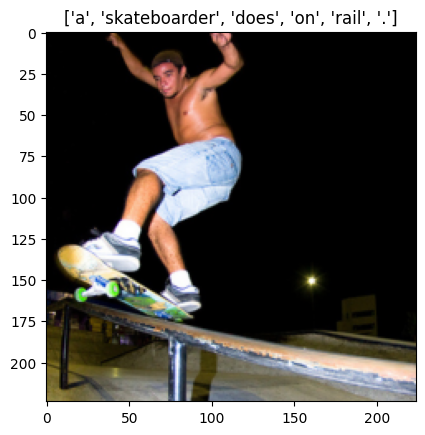


 * LOSS - 3.451, BLEU-4 - 0.128094307076732

Epoch: [13][0/253]	Batch Time 2.750 (2.750)	Data Load Time 1.821 (1.821)	Loss 2.7237 (2.7237)	
Epoch: [13][100/253]	Batch Time 95.991 (49.406)	Data Load Time 95.087 (48.493)	Loss 2.6693 (2.7107)	
Epoch: [13][200/253]	Batch Time 188.689 (95.860)	Data Load Time 187.771 (94.949)	Loss 2.7238 (2.7377)	
Validation: [0/32]	Batch Time 2.217 (2.217)	Loss 3.5185 (3.5185)	
[['two', 'male', 'spectators']]


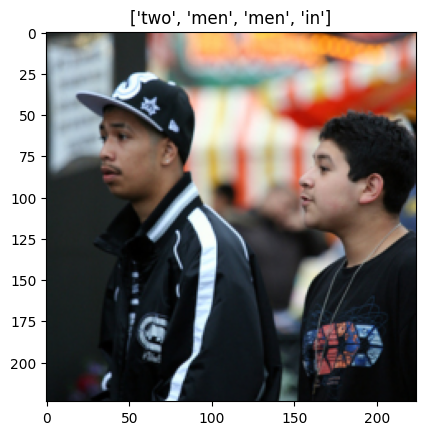


 * LOSS - 3.450, BLEU-4 - 0.12860368815180623

Epoch: [14][0/253]	Batch Time 2.792 (2.792)	Data Load Time 1.828 (1.828)	Loss 2.6162 (2.6162)	
Epoch: [14][100/253]	Batch Time 95.503 (49.298)	Data Load Time 94.593 (48.390)	Loss 2.7096 (2.6371)	
Epoch: [14][200/253]	Batch Time 188.231 (95.665)	Data Load Time 187.396 (94.756)	Loss 2.7936 (2.6665)	
Validation: [0/32]	Batch Time 2.254 (2.254)	Loss 3.4007 (3.4007)	
[['two', 'male', 'spectators']]


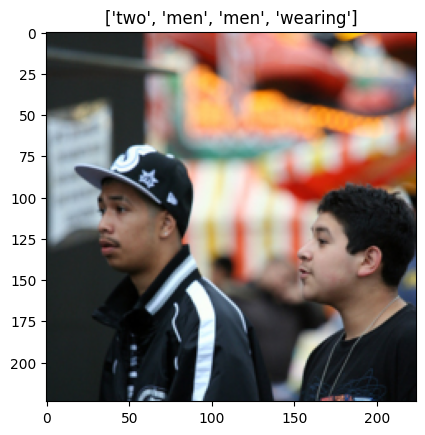


 * LOSS - 3.453, BLEU-4 - 0.13028351760786713

Epoch: [15][0/253]	Batch Time 2.737 (2.737)	Data Load Time 1.780 (1.780)	Loss 2.5453 (2.5453)	
Epoch: [15][100/253]	Batch Time 95.717 (49.233)	Data Load Time 94.807 (48.322)	Loss 2.5727 (2.5727)	
Epoch: [15][200/253]	Batch Time 188.144 (95.645)	Data Load Time 187.260 (94.737)	Loss 2.6483 (2.5974)	
Validation: [0/32]	Batch Time 2.434 (2.434)	Loss 3.5413 (3.5413)	
[['three', 'children', 'playy', 'together', '.']]


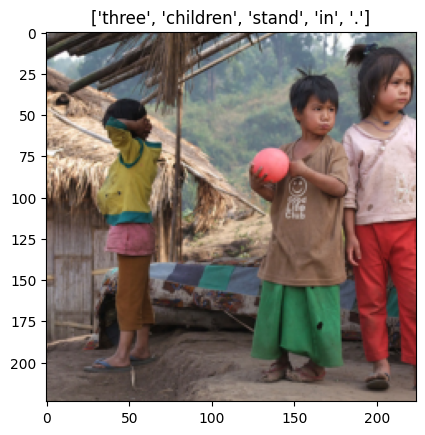


 * LOSS - 3.454, BLEU-4 - 0.13036357120414263

Epoch: [16][0/253]	Batch Time 2.670 (2.670)	Data Load Time 1.735 (1.735)	Loss 2.4313 (2.4313)	
Epoch: [16][100/253]	Batch Time 95.071 (48.879)	Data Load Time 94.168 (47.974)	Loss 2.5000 (2.5122)	
Epoch: [16][200/253]	Batch Time 187.732 (95.124)	Data Load Time 186.835 (94.218)	Loss 2.7077 (2.5297)	
Validation: [0/32]	Batch Time 2.172 (2.172)	Loss 3.5496 (3.5496)	
[['a', 'greyhound', 'racing', '.']]


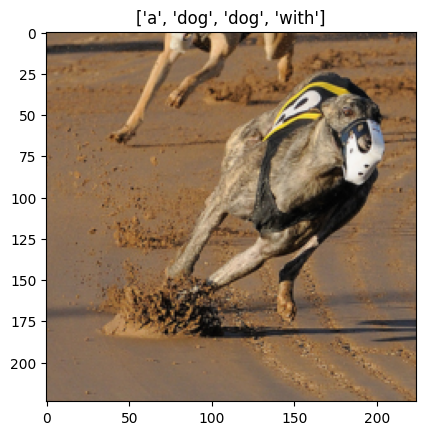


 * LOSS - 3.472, BLEU-4 - 0.12826399506219985


Epochs since last improvement: 1

Epoch: [17][0/253]	Batch Time 2.745 (2.745)	Data Load Time 1.787 (1.787)	Loss 2.4316 (2.4316)	
Epoch: [17][100/253]	Batch Time 95.467 (49.176)	Data Load Time 94.546 (48.267)	Loss 2.4638 (2.4399)	
Epoch: [17][200/253]	Batch Time 187.983 (95.511)	Data Load Time 187.122 (94.604)	Loss 2.4073 (2.4673)	
Validation: [0/32]	Batch Time 2.166 (2.166)	Loss 3.4816 (3.4816)	
[['a', 'snowboarder', 'jumping', '.']]


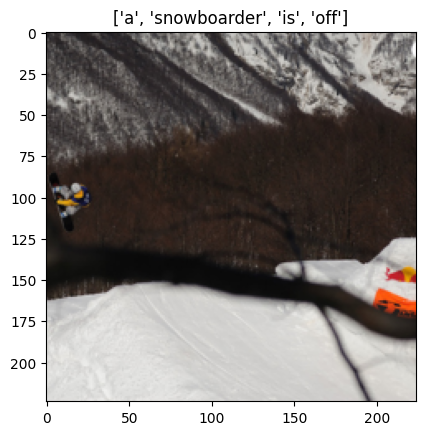


 * LOSS - 3.482, BLEU-4 - 0.12955245439741384


Epochs since last improvement: 2

Epoch: [18][0/253]	Batch Time 2.710 (2.710)	Data Load Time 1.698 (1.698)	Loss 2.3822 (2.3822)	
Epoch: [18][100/253]	Batch Time 95.104 (49.039)	Data Load Time 94.205 (48.134)	Loss 2.3713 (2.3858)	
Epoch: [18][200/253]	Batch Time 187.388 (95.165)	Data Load Time 186.489 (94.260)	Loss 2.5073 (2.4113)	
Validation: [0/32]	Batch Time 2.204 (2.204)	Loss 3.4748 (3.4748)	
[['two', 'girls', 'karate', 'fighting']]


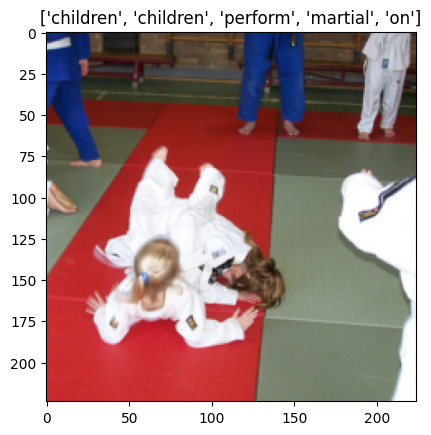


 * LOSS - 3.484, BLEU-4 - 0.12922001491383012


Epochs since last improvement: 3

Epoch: [19][0/253]	Batch Time 2.685 (2.685)	Data Load Time 1.749 (1.749)	Loss 2.2895 (2.2895)	
Epoch: [19][100/253]	Batch Time 95.536 (48.995)	Data Load Time 94.632 (48.086)	Loss 2.3270 (2.3313)	
Epoch: [19][200/253]	Batch Time 188.307 (95.440)	Data Load Time 187.390 (94.531)	Loss 2.3479 (2.3561)	
Validation: [0/32]	Batch Time 2.222 (2.222)	Loss 3.3790 (3.3790)	
[['man', 'throws', 'flames', 'outside', '.']]


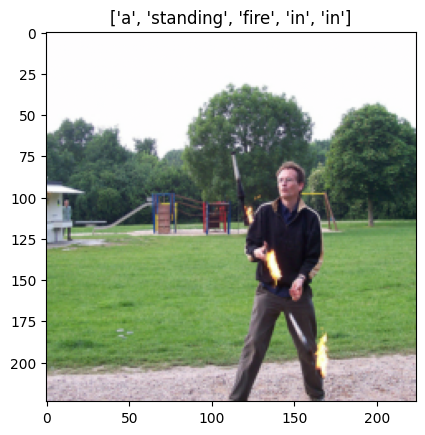


 * LOSS - 3.505, BLEU-4 - 0.13002379436364822


Epochs since last improvement: 4

Epoch: [20][0/253]	Batch Time 2.681 (2.681)	Data Load Time 1.735 (1.735)	Loss 2.1843 (2.1843)	
Epoch: [20][100/253]	Batch Time 95.089 (48.971)	Data Load Time 94.209 (48.066)	Loss 2.3359 (2.2724)	
Epoch: [20][200/253]	Batch Time 188.140 (95.231)	Data Load Time 187.226 (94.323)	Loss 2.2670 (2.3023)	
Validation: [0/32]	Batch Time 2.243 (2.243)	Loss 3.4405 (3.4405)	
[['fast', 'paced', 'basketball', 'action']]


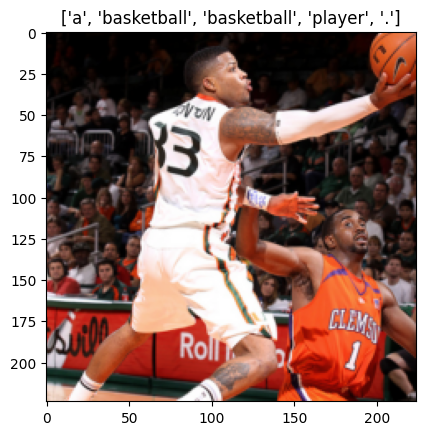


 * LOSS - 3.523, BLEU-4 - 0.1292748207084653


Epochs since last improvement: 5

Epoch: [21][0/253]	Batch Time 2.751 (2.751)	Data Load Time 1.823 (1.823)	Loss 2.2417 (2.2417)	
Epoch: [21][100/253]	Batch Time 95.750 (49.513)	Data Load Time 94.836 (48.602)	Loss 2.2538 (2.2250)	
Epoch: [21][200/253]	Batch Time 188.269 (95.745)	Data Load Time 187.374 (94.836)	Loss 2.2688 (2.2525)	
Validation: [0/32]	Batch Time 2.225 (2.225)	Loss 3.6765 (3.6765)	
[['a', 'golden', 'retriever', 'nurses', 'puppies', '.']]


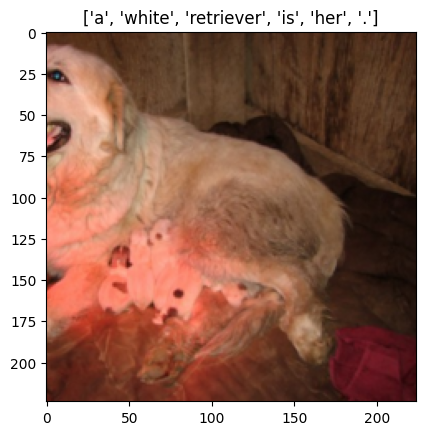


 * LOSS - 3.542, BLEU-4 - 0.12693235471335956


Epochs since last improvement: 6

Epoch: [22][0/253]	Batch Time 2.827 (2.827)	Data Load Time 1.785 (1.785)	Loss 2.1581 (2.1581)	
Epoch: [22][100/253]	Batch Time 95.117 (49.058)	Data Load Time 94.228 (48.153)	Loss 2.2328 (2.1800)	
Epoch: [22][200/253]	Batch Time 187.900 (95.301)	Data Load Time 186.996 (94.394)	Loss 2.3717 (2.2028)	
Validation: [0/32]	Batch Time 2.287 (2.287)	Loss 3.5091 (3.5091)	
[['a', 'greyhound', 'racing', '.']]


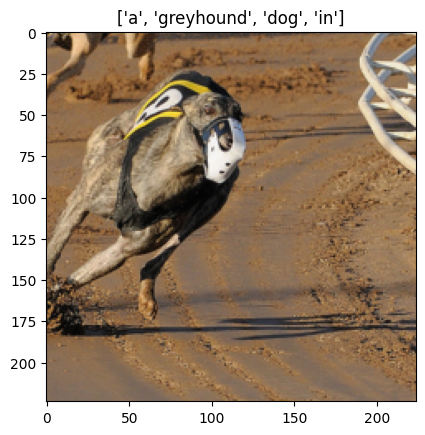


 * LOSS - 3.557, BLEU-4 - 0.12821524878629761


Epochs since last improvement: 7

Epoch: [23][0/253]	Batch Time 2.973 (2.973)	Data Load Time 2.072 (2.072)	Loss 2.0526 (2.0526)	
Epoch: [23][100/253]	Batch Time 95.284 (49.396)	Data Load Time 94.410 (48.492)	Loss 2.1881 (2.1298)	
Epoch: [23][200/253]	Batch Time 187.948 (95.418)	Data Load Time 187.057 (94.512)	Loss 2.2372 (2.1578)	
Validation: [0/32]	Batch Time 2.104 (2.104)	Loss 3.8437 (3.8437)	
[['a', 'cold', 'cycler', 'celebrates', '.']]


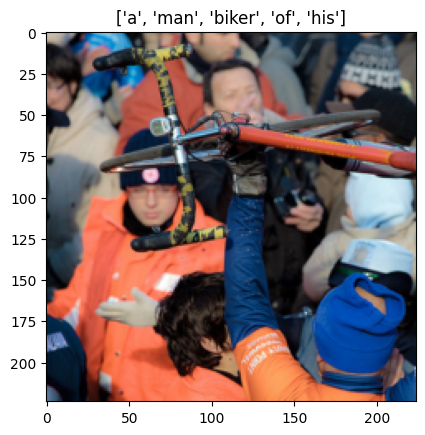


 * LOSS - 3.582, BLEU-4 - 0.12837616308012725


Epochs since last improvement: 8


DECAYING learning rate.
The new learning rate is 0.000240


DECAYING learning rate.
The new learning rate is 0.000080

Epoch: [24][0/253]	Batch Time 2.781 (2.781)	Data Load Time 1.834 (1.834)	Loss 2.0445 (2.0445)	
Epoch: [24][100/253]	Batch Time 95.735 (49.164)	Data Load Time 94.743 (48.253)	Loss 2.0346 (2.0734)	
Epoch: [24][200/253]	Batch Time 188.215 (95.612)	Data Load Time 187.289 (94.704)	Loss 2.1023 (2.0887)	
Validation: [0/32]	Batch Time 2.169 (2.169)	Loss 3.6806 (3.6806)	
[['a', 'boy', 'screams', '.']]


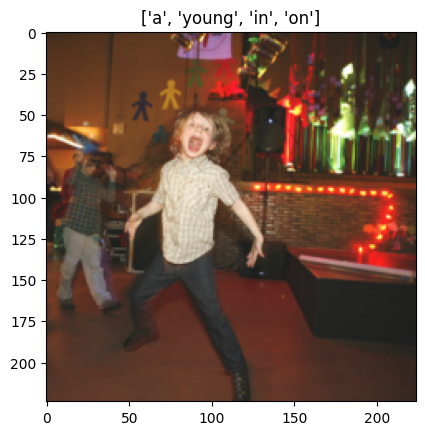


 * LOSS - 3.604, BLEU-4 - 0.12702031304669548


Epochs since last improvement: 9

Epoch: [25][0/253]	Batch Time 2.662 (2.662)	Data Load Time 1.721 (1.721)	Loss 2.0064 (2.0064)	
Epoch: [25][100/253]	Batch Time 95.353 (48.947)	Data Load Time 94.430 (48.039)	Loss 2.0936 (2.0143)	
Epoch: [25][200/253]	Batch Time 187.729 (95.201)	Data Load Time 186.835 (94.295)	Loss 2.0278 (2.0370)	
Validation: [0/32]	Batch Time 2.205 (2.205)	Loss 3.6447 (3.6447)	
[['miami', 'basketball', 'player', 'shooting']]


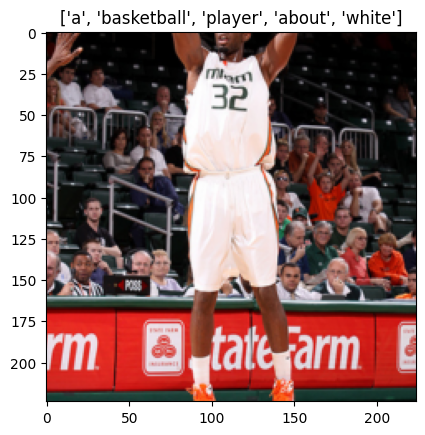


 * LOSS - 3.624, BLEU-4 - 0.12513880941885205


Epochs since last improvement: 10

Epoch: [26][0/253]	Batch Time 2.741 (2.741)	Data Load Time 1.775 (1.775)	Loss 1.9505 (1.9505)	
Epoch: [26][100/253]	Batch Time 95.537 (49.341)	Data Load Time 94.622 (48.432)	Loss 1.9805 (1.9743)	
Epoch: [26][200/253]	Batch Time 188.245 (95.609)	Data Load Time 187.291 (94.701)	Loss 2.0748 (1.9989)	
Validation: [0/32]	Batch Time 2.152 (2.152)	Loss 3.5786 (3.5786)	
[['a', 'person', 'driving', 'a', 'green', 'motorcycle']]


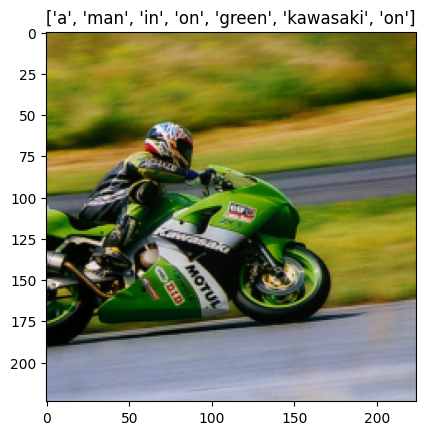


 * LOSS - 3.652, BLEU-4 - 0.1264129313624017


Epochs since last improvement: 11

Epoch: [27][0/253]	Batch Time 2.767 (2.767)	Data Load Time 1.769 (1.769)	Loss 1.9806 (1.9806)	
Epoch: [27][100/253]	Batch Time 95.427 (49.239)	Data Load Time 94.541 (48.330)	Loss 1.8968 (1.9532)	
Epoch: [27][200/253]	Batch Time 187.740 (95.415)	Data Load Time 186.870 (94.509)	Loss 2.0540 (1.9720)	
Validation: [0/32]	Batch Time 2.257 (2.257)	Loss 3.7041 (3.7041)	
[['a', 'rock', 'climber', 'ascends', '.']]


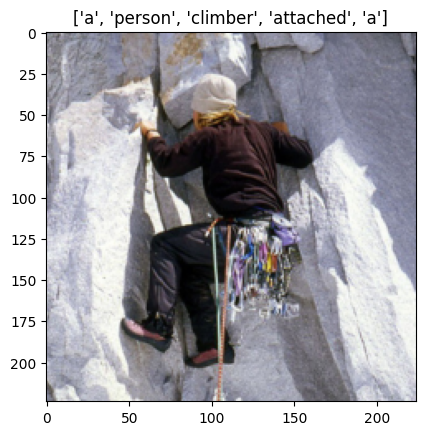


 * LOSS - 3.669, BLEU-4 - 0.1272145169322979


Epochs since last improvement: 12

Epoch: [28][0/253]	Batch Time 2.699 (2.699)	Data Load Time 1.769 (1.769)	Loss 1.8782 (1.8782)	
Epoch: [28][100/253]	Batch Time 95.610 (49.207)	Data Load Time 94.729 (48.297)	Loss 1.9778 (1.9049)	
Epoch: [28][200/253]	Batch Time 188.341 (95.576)	Data Load Time 187.444 (94.667)	Loss 1.9971 (1.9315)	
Validation: [0/32]	Batch Time 2.175 (2.175)	Loss 3.6576 (3.6576)	
[['two', 'men', 'wearing', 'sunglasses', '.']]


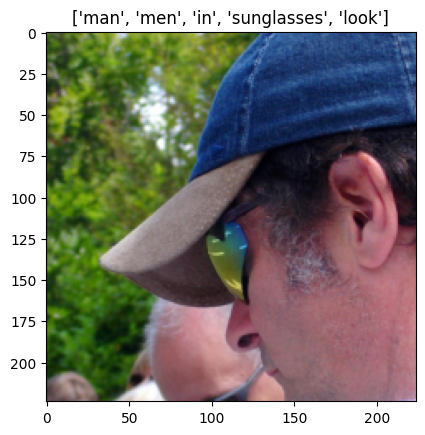


 * LOSS - 3.693, BLEU-4 - 0.1252509446236074


Epochs since last improvement: 13

Epoch: [29][0/253]	Batch Time 2.755 (2.755)	Data Load Time 1.699 (1.699)	Loss 1.8210 (1.8210)	
Epoch: [29][100/253]	Batch Time 95.455 (49.098)	Data Load Time 94.548 (48.188)	Loss 1.9033 (1.8817)	
Epoch: [29][200/253]	Batch Time 187.935 (95.393)	Data Load Time 187.024 (94.486)	Loss 1.9899 (1.9046)	
Validation: [0/32]	Batch Time 2.254 (2.254)	Loss 3.6496 (3.6496)	
[['parachuter', 'in', 'midair', '.']]


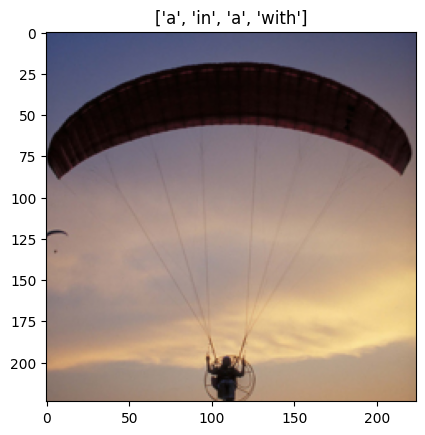


 * LOSS - 3.714, BLEU-4 - 0.12484349361970148


Epochs since last improvement: 14

Epoch: [30][0/253]	Batch Time 2.757 (2.757)	Data Load Time 1.801 (1.801)	Loss 1.8393 (1.8393)	
Epoch: [30][100/253]	Batch Time 95.701 (49.287)	Data Load Time 94.780 (48.376)	Loss 1.8687 (1.8506)	
Epoch: [30][200/253]	Batch Time 188.202 (95.628)	Data Load Time 187.291 (94.720)	Loss 1.9160 (1.8713)	
Validation: [0/32]	Batch Time 2.201 (2.201)	Loss 3.6126 (3.6126)	
[['a', 'band', 'performs', '.']]


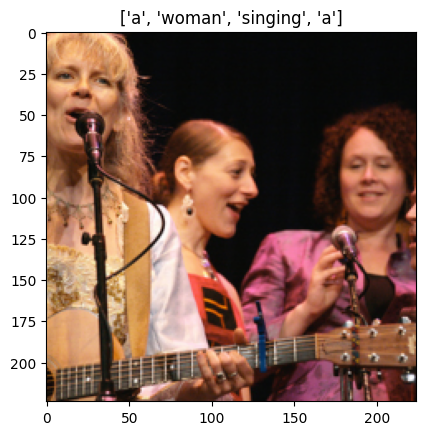


 * LOSS - 3.744, BLEU-4 - 0.12412184677355408


Epochs since last improvement: 15

Epoch: [31][0/253]	Batch Time 2.711 (2.711)	Data Load Time 1.774 (1.774)	Loss 1.7736 (1.7736)	
Epoch: [31][100/253]	Batch Time 95.281 (49.068)	Data Load Time 94.456 (48.161)	Loss 1.8817 (1.8199)	
Epoch: [31][200/253]	Batch Time 188.137 (95.428)	Data Load Time 187.253 (94.520)	Loss 1.8223 (1.8410)	
Validation: [0/32]	Batch Time 2.166 (2.166)	Loss 3.7169 (3.7169)	
[['a', 'boy', 'scales', 'the', 'wall', '.']]


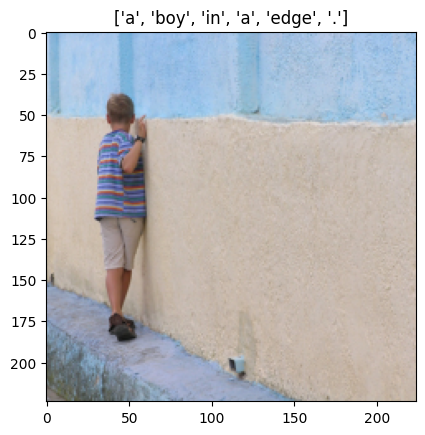


 * LOSS - 3.767, BLEU-4 - 0.12355121936152703


Epochs since last improvement: 16


DECAYING learning rate.
The new learning rate is 0.000192


DECAYING learning rate.
The new learning rate is 0.000064

Epoch: [32][0/253]	Batch Time 2.722 (2.722)	Data Load Time 1.794 (1.794)	Loss 1.8039 (1.8039)	
Epoch: [32][100/253]	Batch Time 95.255 (48.975)	Data Load Time 94.346 (48.068)	Loss 1.7542 (1.7815)	
Epoch: [32][200/253]	Batch Time 187.963 (95.213)	Data Load Time 187.076 (94.306)	Loss 1.7913 (1.7962)	
Validation: [0/32]	Batch Time 2.492 (2.492)	Loss 3.9402 (3.9402)	
[['kids', 'riding', 'the', 'subway']]


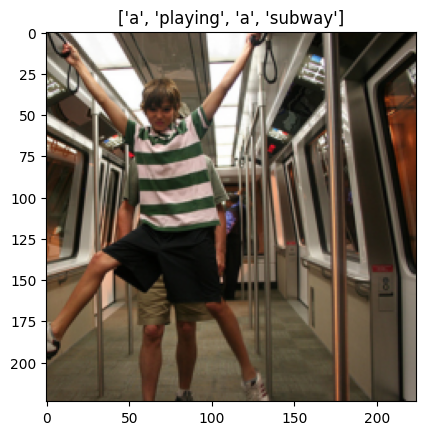


 * LOSS - 3.798, BLEU-4 - 0.12440800716853914


Epochs since last improvement: 17

Epoch: [33][0/253]	Batch Time 2.655 (2.655)	Data Load Time 1.753 (1.753)	Loss 1.7275 (1.7275)	
Epoch: [33][100/253]	Batch Time 95.294 (49.078)	Data Load Time 94.401 (48.171)	Loss 1.7755 (1.7474)	
Epoch: [33][200/253]	Batch Time 188.372 (95.575)	Data Load Time 187.465 (94.665)	Loss 1.7383 (1.7603)	
Validation: [0/32]	Batch Time 2.194 (2.194)	Loss 3.7870 (3.7870)	
[['a', 'bird', 'eating', '.']]


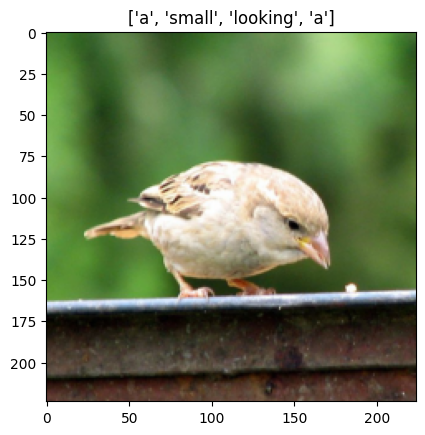


 * LOSS - 3.820, BLEU-4 - 0.12221665004304558


Epochs since last improvement: 18

Epoch: [34][0/253]	Batch Time 2.730 (2.730)	Data Load Time 1.788 (1.788)	Loss 1.6781 (1.6781)	
Epoch: [34][100/253]	Batch Time 95.094 (48.993)	Data Load Time 94.183 (48.088)	Loss 1.7526 (1.7195)	
Epoch: [34][200/253]	Batch Time 187.438 (95.124)	Data Load Time 186.542 (94.219)	Loss 1.7760 (1.7348)	
Validation: [0/32]	Batch Time 2.168 (2.168)	Loss 3.8082 (3.8082)	
[['a', 'woman', 'jogger', '.']]


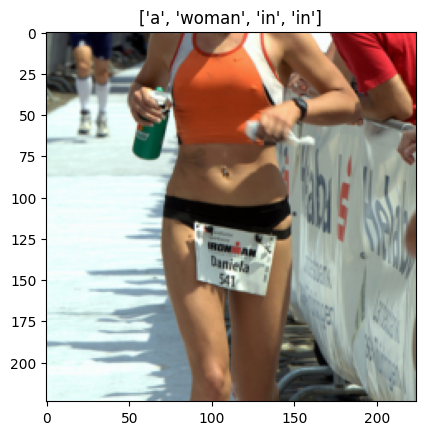


 * LOSS - 3.841, BLEU-4 - 0.12108041686944279


Epochs since last improvement: 19

Epoch: [35][0/253]	Batch Time 2.737 (2.737)	Data Load Time 1.813 (1.813)	Loss 1.6722 (1.6722)	
Epoch: [35][100/253]	Batch Time 95.475 (49.195)	Data Load Time 94.586 (48.287)	Loss 1.7614 (1.6967)	
Epoch: [35][200/253]	Batch Time 188.771 (95.644)	Data Load Time 187.878 (94.733)	Loss 1.7632 (1.7124)	
Validation: [0/32]	Batch Time 2.214 (2.214)	Loss 3.7771 (3.7771)	
[['two', 'soccer', 'teams', 'compete', '.']]


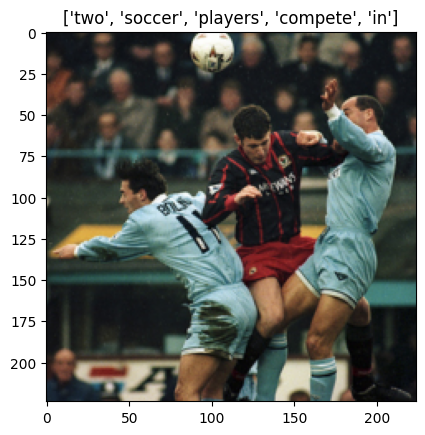


 * LOSS - 3.858, BLEU-4 - 0.12390678256571189


Epochs since last improvement: 20



In [46]:
for epoch in range(start_epoch, epochs):
    # Decay learning rate if there is no improvement for 8 consecutive epochs, and terminate training after 20
    if epochs_since_improvement == 20:
        break
    if epochs_since_improvement > 0 and epochs_since_improvement % 8 == 0:
        adjust_learning_rate(decoder_optimizer, 0.8)
        if fine_tune_encoder:
            adjust_learning_rate(encoder_optimizer, 0.8)

    # One epoch's training
    train(train_loader= train_loader,
          encoder=encoder,
          decoder=decoder,
          criterion=criterion,
          encoder_optimizer=encoder_optimizer,
          decoder_optimizer=decoder_optimizer,
          epoch=epoch)

    # One epoch's validation
    recent_bleu4 = validate(val_loader = val_loader,
                            encoder=encoder,
                            decoder=decoder,
                            criterion=criterion)

    # Check if there was an improvement
    is_best = recent_bleu4 > best_bleu4
    best_bleu4 = max(recent_bleu4, best_bleu4)
    if not is_best:
        epochs_since_improvement += 1
        print("\nEpochs since last improvement: %d\n" % (epochs_since_improvement,))
    else:
        epochs_since_improvement = 0

    save_checkpoint(data_name, epoch, epochs_since_improvement, encoder, decoder, encoder_optimizer,
                        decoder_optimizer, recent_bleu4, is_best)


# Generate Caption

In [72]:
def caption_image_beam_search(encoder, decoder, image, vocab, beam_size=3):
    """
    Reads an image and captions it with beam search.

    :param encoder: encoder model
    :param decoder: decoder model
    :param image_path: path to image
    :param word_map: word map
    :param beam_size: number of sequences to consider at each decode-step
    :return: caption, weights for visualization
    """

    k = beam_size
    vocab_size = len(vocab.stoi)

    # Encode
    image = image.unsqueeze(0)  # (1, 3, 256, 256)
    encoder_out = encoder(image)  # (1, enc_image_size, enc_image_size, encoder_dim)
    enc_image_size = encoder_out.size(1)
    encoder_dim = encoder_out.size(3)

    # Flatten encoding
    encoder_out = encoder_out.view(1, -1, encoder_dim)  # (1, num_pixels, encoder_dim)
    num_pixels = encoder_out.size(1)

    # We'll treat the problem as having a batch size of k
    encoder_out = encoder_out.expand(k, num_pixels, encoder_dim)  # (k, num_pixels, encoder_dim)

    # Tensor to store top k previous words at each step; now they're just <start>
    k_prev_words = torch.LongTensor([[vocab.stoi['<SOS>']]] * k).to(device)  # (k, 1)

    # Tensor to store top k sequences; now they're just <start>
    seqs = k_prev_words  # (k, 1)

    # Tensor to store top k sequences' scores; now they're just 0
    top_k_scores = torch.zeros(k, 1).to(device)  # (k, 1)

    # Tensor to store top k sequences' alphas; now they're just 1s
    seqs_alpha = torch.ones(k, 1, enc_image_size, enc_image_size).to(device)  # (k, 1, enc_image_size, enc_image_size)

    # Lists to store completed sequences, their alphas and scores
    complete_seqs = list()
    complete_seqs_alpha = list()
    complete_seqs_scores = list()

    # Start decoding
    step = 1
    h, c = decoder.init_hidden_state(encoder_out)

    # s is a number less than or equal to k, because sequences are removed from this process once they hit <end>
    while True:

        embeddings = decoder.embedding(k_prev_words).squeeze(1)  # (s, embed_dim)

        awe, alpha = decoder.attention(encoder_out, h)  # (s, encoder_dim), (s, num_pixels)

        alpha = alpha.view(-1, enc_image_size, enc_image_size)  # (s, enc_image_size, enc_image_size)

        gate = decoder.sigmoid(decoder.f_beta(h))  # gating scalar, (s, encoder_dim)
        awe = gate * awe

        h, c = decoder.decode_step(torch.cat([embeddings, awe], dim=1), (h, c))  # (s, decoder_dim)

        scores = decoder.fc(h)  # (s, vocab_size)
        scores = F.log_softmax(scores, dim=1)

        # Add
        scores = top_k_scores.expand_as(scores) + scores  # (s, vocab_size)

        # For the first step, all k points will have the same scores (since same k previous words, h, c)
        if step == 1:
            top_k_scores, top_k_words = scores[0].topk(k, 0, True, True)  # (s)
        else:
            # Unroll and find top scores, and their unrolled indices
            top_k_scores, top_k_words = scores.view(-1).topk(k, 0, True, True)  # (s)

        # Convert unrolled indices to actual indices of scores
        prev_word_inds = (top_k_words / vocab_size).long()  # (s)
        next_word_inds = (top_k_words % vocab_size).long()  # (s)

        # Add new words to sequences, alphas
        seqs = torch.cat([seqs[prev_word_inds], next_word_inds.unsqueeze(1)], dim=1)  # (s, step+1)
        seqs_alpha = torch.cat([seqs_alpha[prev_word_inds], alpha[prev_word_inds].unsqueeze(1)],
                               dim=1)  # (s, step+1, enc_image_size, enc_image_size)

        # Which sequences are incomplete (didn't reach <end>)?
        incomplete_inds = [ind for ind, next_word in enumerate(next_word_inds) if
                           next_word != vocab.stoi['<EOS>']]
        complete_inds = list(set(range(len(next_word_inds))) - set(incomplete_inds))

        # Set aside complete sequences
        if len(complete_inds) > 0:
            complete_seqs.extend(seqs[complete_inds].tolist())
            complete_seqs_alpha.extend(seqs_alpha[complete_inds].tolist())
            complete_seqs_scores.extend(top_k_scores[complete_inds])
        k -= len(complete_inds)  # reduce beam length accordingly

        # Proceed with incomplete sequences
        if k == 0:
            break
        seqs = seqs[incomplete_inds]
        seqs_alpha = seqs_alpha[incomplete_inds]
        h = h[prev_word_inds[incomplete_inds]]
        c = c[prev_word_inds[incomplete_inds]]
        encoder_out = encoder_out[prev_word_inds[incomplete_inds]]
        top_k_scores = top_k_scores[incomplete_inds].unsqueeze(1)
        k_prev_words = next_word_inds[incomplete_inds].unsqueeze(1)

        # Break if things have been going on too long
        if step > 50:
            break
        step += 1

    i = complete_seqs_scores.index(max(complete_seqs_scores))
    seq = complete_seqs[i]
    alphas = complete_seqs_alpha[i]

    return seq, alphas

In [74]:
def caption_image_beam_search_no_attention(encoder, decoder, image, vocab, beam_size=3):
    """
    Reads an image and captions it with beam search.

    :param encoder: encoder model
    :param decoder: decoder model
    :param image_path: path to image
    :param word_map: word map
    :param beam_size: number of sequences to consider at each decode-step
    :return: caption, weights for visualization
    """

    k = beam_size
    vocab_size = len(vocab.stoi)

    # Encode
    image = image.unsqueeze(0)  # (1, 3, 256, 256)
    encoder_out = encoder(image)  # (1, enc_image_size, enc_image_size, encoder_dim)
    enc_image_size = encoder_out.size(1)
    encoder_dim = encoder_out.size(3)

    # Flatten encoding
    encoder_out = encoder_out.view(1, -1, encoder_dim)  # (1, num_pixels, encoder_dim)
    num_pixels = encoder_out.size(1)

    # We'll treat the problem as having a batch size of k
    encoder_out = encoder_out.expand(k, num_pixels, encoder_dim)  # (k, num_pixels, encoder_dim)

    # Tensor to store top k previous words at each step; now they're just <start>
    k_prev_words = torch.LongTensor([[vocab.stoi['<SOS>']]] * k).to(device)  # (k, 1)

    # Tensor to store top k sequences; now they're just <start>
    seqs = k_prev_words  # (k, 1)

    # Tensor to store top k sequences' scores; now they're just 0
    top_k_scores = torch.zeros(k, 1).to(device)  # (k, 1)

    # Lists to store completed sequences, their alphas and scores
    complete_seqs = list()
    complete_seqs_scores = list()

    # Start decoding
    step = 1
    h, c = decoder.init_hidden_state(encoder_out)

    # s is a number less than or equal to k, because sequences are removed from this process once they hit <end>
    while True:

        embeddings = decoder.embedding(k_prev_words).squeeze(1)  # (s, embed_dim)

        h, c = decoder.decode_step(embeddings, (h, c))  # (s, decoder_dim)

        scores = decoder.fc(h)  # (s, vocab_size)
        scores = F.log_softmax(scores, dim=1)

        # Add
        scores = top_k_scores.expand_as(scores) + scores  # (s, vocab_size)

        # For the first step, all k points will have the same scores (since same k previous words, h, c)
        if step == 1:
            top_k_scores, top_k_words = scores[0].topk(k, 0, True, True)  # (s)
        else:
            # Unroll and find top scores, and their unrolled indices
            top_k_scores, top_k_words = scores.view(-1).topk(k, 0, True, True)  # (s)

        # Convert unrolled indices to actual indices of scores
        prev_word_inds = (top_k_words / vocab_size).long()  # (s)
        next_word_inds = (top_k_words % vocab_size).long()  # (s)

        # Add new words to sequences, alphas
        seqs = torch.cat([seqs[prev_word_inds], next_word_inds.unsqueeze(1)], dim=1)  # (s, step+1)
    
        # Which sequences are incomplete (didn't reach <end>)?
        incomplete_inds = [ind for ind, next_word in enumerate(next_word_inds) if
                           next_word != vocab.stoi['<EOS>']]
        complete_inds = list(set(range(len(next_word_inds))) - set(incomplete_inds))

        # Set aside complete sequences
        if len(complete_inds) > 0:
            complete_seqs.extend(seqs[complete_inds].tolist())
            complete_seqs_scores.extend(top_k_scores[complete_inds])
        k -= len(complete_inds)  # reduce beam length accordingly

        # Proceed with incomplete sequences
        if k == 0:
            break
        seqs = seqs[incomplete_inds]
        h = h[prev_word_inds[incomplete_inds]]
        c = c[prev_word_inds[incomplete_inds]]
        encoder_out = encoder_out[prev_word_inds[incomplete_inds]]
        top_k_scores = top_k_scores[incomplete_inds].unsqueeze(1)
        k_prev_words = next_word_inds[incomplete_inds].unsqueeze(1)

        # Break if things have been going on too long
        if step > 50:
            break
        step += 1

    i = complete_seqs_scores.index(max(complete_seqs_scores))
    seq = complete_seqs[i]

    return seq

# Result

In [75]:
dataset.allCaps = True
val_dataset.allCaps = True

test_loader = DataLoader(
    dataset=val_dataset,
    batch_size=8,
    num_workers=NUM_WORKER,
    shuffle=True,
    collate_fn = CapsCollate(pad_idx, batch_first=True, allCaps = True),
)

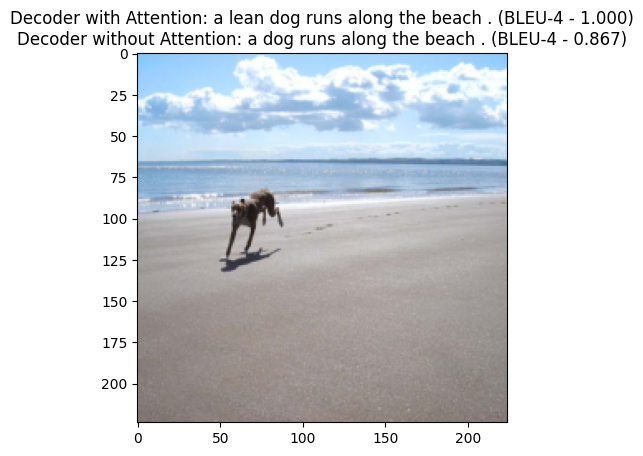

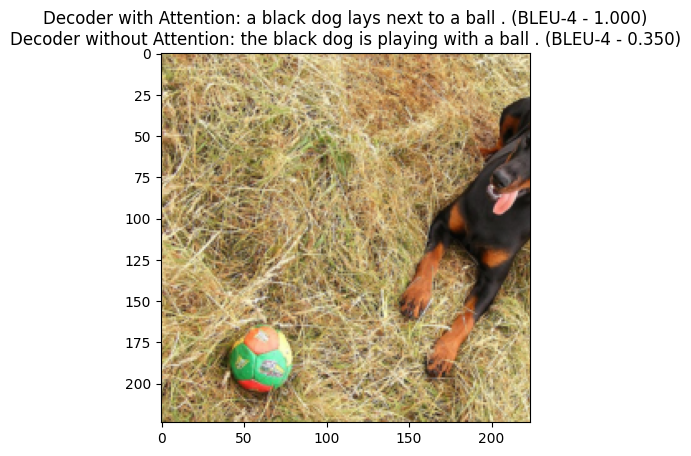

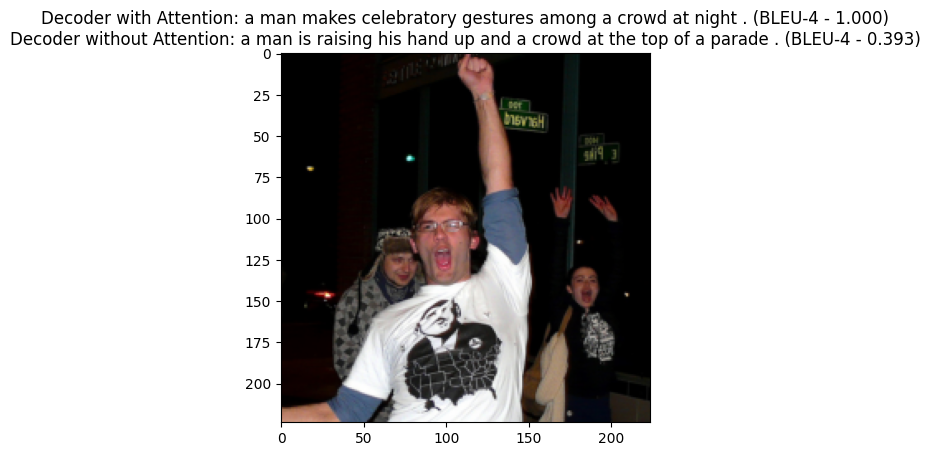

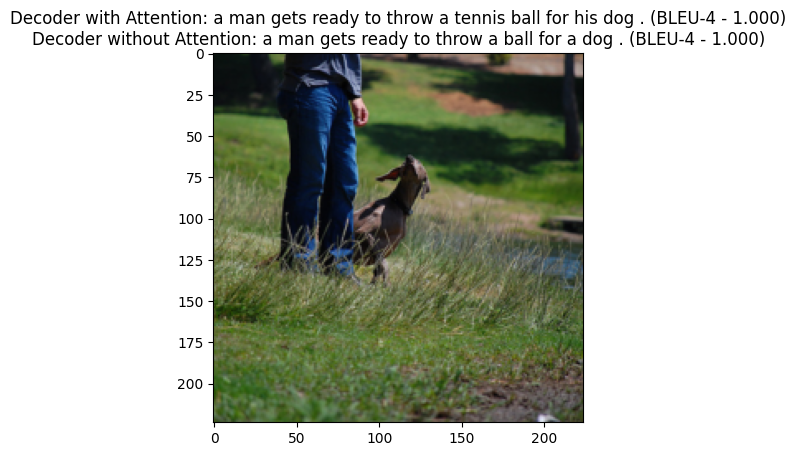

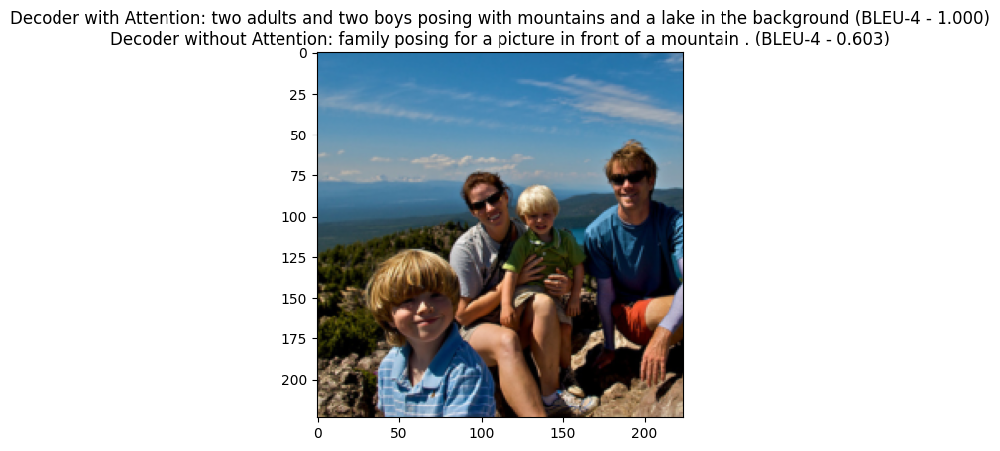

In [94]:
decoder_noAtt = decoder_noAtt.to(device)
encoder_noAtt = encoder_noAtt.to(device)

encoder_noAtt.eval()
decoder_noAtt.eval()
smoothie = SmoothingFunction().method4

for i, (img, cap, allCaps) in enumerate(test_loader):
    imgs = img.to(device) 
    if i == 5:
        break
        
    seq1, alpha = caption_image_beam_search(encoder, decoder, imgs[0], vocab)
    seq2 = caption_image_beam_search_no_attention(encoder_noAtt, decoder_noAtt, imgs[0], vocab)
    
    bleu_score_attention = corpus_bleu([allCaps[0]], [seq1[1:-1]], smoothing_function = smoothie)
    bleu_score = corpus_bleu([allCaps[0]], [seq2[1:-1]], smoothing_function = smoothie)
    
    caption1 = ' '.join([vocab.itos[token] for token in seq1[1:-1]])
    caption2 = ' '.join([vocab.itos[token] for token in seq2[1:-1]])
    
    strings = ('Decoder with Attention: {0} (BLEU-4 - {1:.3f})\n'
              'Decoder without Attention: {2} (BLEU-4 - {3:.3f})').format(caption1, bleu_score_attention, 
                                                                          caption2, bleu_score)
    show_image(img[0], title = strings)